In [1]:
# Load libraries
import pandas as pd 
import scanpy as sc
import numpy as np
import scipy.sparse
import scvi 
import celltypist 
import matplotlib.pyplot as plt
import seaborn as sns

/opt/conda/envs/we_multiome/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
Global seed set to 0


# Read in data

In [2]:
dataset= sc.read_h5ad('/home/jupyter/mount/gdrive/meninges/embedded_matrix.h5ad')

In [3]:
dataset

AnnData object with n_obs × n_vars = 46578 × 4005
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'cranial_caudal_colors', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'pca', 'predicted_labels_colors', 'ra

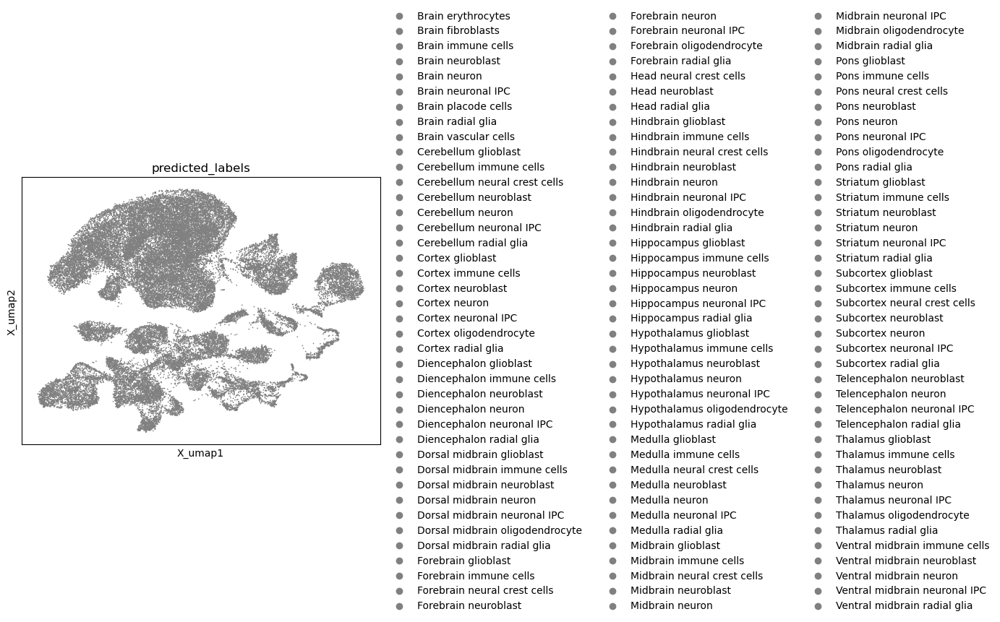

In [4]:
sc.pl.embedding(dataset, 'X_umap', color=[ "predicted_labels"],  size= 6)

# Markers 

In [4]:
# Markers

T_Cells= {'CD8 TRM' : ['CD8A', 'RUNX3', 'CD69', 'CD44'], 
          "CD8_cytotoxic": ["CD8A", "GZMB", "CCL5"],
        "CD8" : ["CD8A", "CD8B", "SELL"],
"Treg": ["FOXP3", "CTLA4"],
"CD4_TCM-like": ["SELL", "CCR7", "S1PR1"],
"CD4_TRM": ["CCR4", "FOXP1", "CD69"],
"CD4_Th": ["RORA", "FOXP1", "CCR4"],
"CD4_Th2": ["GATA3", "PPARG", "IL13"],
"Proliferating_TRM": ["FABP5", "MKI67"],
"CD4_Th1": ["TBX21", "STAT1"],
"CD4_Th17": ["RORC"]}

markers = {'MATURE_T':['CCR7','CD5','CD27','CD8A','CD8B','CD4'], 
           #'agonist selection':['TNFRSF9','CD27','IKZF2','IKZF3'],
           'Treg':['FOXP3','CTLA4'], 
           'innate':['ZBTB16'],
           'CD8aa':['PDCD1','GNG4'], 
           'TYPE_3_INNATE_T':['CD40LG','RORC','CCR6','ANXA1'],
           'TYPE_1_INNATE_T':['NKG7','EOMES','TBX21','IFNG-AS1','IL4','IFNG']
          
          }

CNS_Markers= {'Neural progenitors' : [ 'OLIG2'], 
          'Glia' : ["NFIA"],
          'Oligodendrocytes': ["SOX10", "SOX9", "PDGFRA", "S100B"], 
          "CNS-Prog": ["SOX2"],
          "CNS-Neuron": ["ELAVL3"],
          "PNS-Prog": ["SOX10"],
          "PNS-Neuron": ["SIX1"],
          "Floorplate": ['PAX7', 'CDH7', 'TXLNB', 'CDHR3', 'PIFO', 'RRAD']}
# Paper 


#Sankowsi et al., 2022 (prepreprint)
CAM_Markers= {'Microglia':[ 'TMEM119','P2RY12',"TREM2"],
              'CAMs': ['MRC1',"CD163", "LYVE1","SIGLEC1","STAB1"]}



# get full gene set 

In [5]:
full_adata = sc.AnnData(dataset.raw.X,obs=dataset.obs,var=dataset.raw.var)

In [6]:
full_adata 

AnnData object with n_obs × n_vars = 46578 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'

In [7]:
full_adata.obs["pcw"].value_counts()

8.4    27656
6.7    17892
Name: pcw, dtype: int64

In [9]:
dataset

AnnData object with n_obs × n_vars = 46578 × 4005
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'cranial_caudal_colors', 'hvg', 'leiden', 'leiden_colors', 'majority_voting_colors', 'neighbors', 'pca', 'predicted_labels_colors', 'ra

# Separate data by age 

In [10]:
PCW6= full_adata[full_adata.obs["pcw"]==6.7].copy()

In [11]:
PCW6

AnnData object with n_obs × n_vars = 17892 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'

In [12]:
PCW8= full_adata[full_adata.obs["pcw"]==8.4].copy()

In [13]:
PCW8

AnnData object with n_obs × n_vars = 27656 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'

# Look at the celltype separation separately across gestation 

## Get SCVI clusters + SCVI clusters for PCW6 

- https://docs.scvi-tools.org/en/stable/tutorials/notebooks/api_overview.html

In [100]:
PCW6.layers["counts"] = PCW6.X.copy() # preserve counts
sc.pp.normalize_total(PCW6, target_sum=1e4)
sc.pp.log1p(PCW6)
PCW6.raw = PCW6 # freeze the state in `.raw`

In [101]:
# sc.pp.highly_variable_genes(
#     PCW6,
#     n_top_genes=1200,
#     subset=True,
#     layer="counts",
#     flavor="seurat_v3",
#     batch_key="run_id"
# )

In [93]:
scvi.model.SCVI.setup_anndata(
    PCW6,
    layer="counts",
    categorical_covariate_keys=["run_id"],
)

/opt/conda/lib/python3.7/site-packages/scvi/data/fields/_layer_field.py:79: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  f"{logger_data_loc} does not contain unnormalized count data. "


In [16]:
model_pcw6 = scvi.model.SCVI(PCW6)

In [17]:
model_pcw6

SCVI Model with the following params: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, 
gene_likelihood: zinb, latent_distribution: normal
Training status: Not Trained

In [18]:
model_pcw6.train()

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/400:   0%|          | 0/400 [00:00<?, ?it/s]

/opt/conda/lib/python3.7/site-packages/scvi/distributions/_negative_binomial.py:438: UserWarning: The value argument must be within the support of the distribution
  UserWarning,
/opt/conda/lib/python3.7/site-packages/scvi/distributions/_negative_binomial.py:63: UserWarning: Specified kernel cache directory could not be created! This disables kernel caching. Specified directory is /home/jupyter/.cache/torch/kernels. This warning will appear only once per process. (Triggered internally at  ../aten/src/ATen/native/cuda/jit_utils.cpp:860.)
  - torch.lgamma(x + 1)


Epoch 400/400: 100%|██████████| 400/400 [09:41<00:00,  1.45s/it, loss=207, v_num=1]


In [200]:
model_pcw6

SCVI Model with the following params: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, 
gene_likelihood: zinb, latent_distribution: normal
Training status: Trained

In [201]:
latent_pcw6 = model_pcw6.get_latent_representation()
PCW6.obsm["X_scVI"] = latent_pcw6 

In [202]:
## visualisation of PCW6 with batch correction with run_id 

In [203]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(PCW6, use_rep="X_scVI",  key_added='X_scVI')
sc.tl.umap(PCW6, min_dist=0.3, neighbors_key='X_scVI')
PCW6.obsm["X_umap_scVI"] = PCW6.obsm["X_umap"].copy()

In [204]:
PCW6

AnnData object with n_obs × n_vars = 17892 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'X_scVI', 'umap'
    obsm: 'X_scVI', 'X_umap', 'X_umap_scVI'
    obsp: 'X_scVI_distances', 'X_scVI_connectivities'

In [205]:
# neighbors were already computed using scVI
sc.tl.leiden(PCW6, key_added="leiden_scVI", resolution=0.5, neighbors_key='X_scVI')

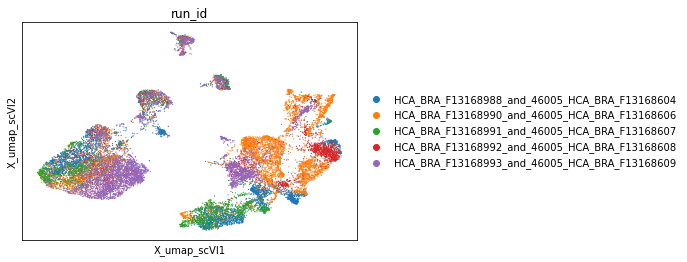

In [206]:
sc.pl.embedding(PCW6, 'X_umap_scVI', color=[  "run_id"],  size= 6, save= "pcw6_batchcorrection_scvi_run_id.png")

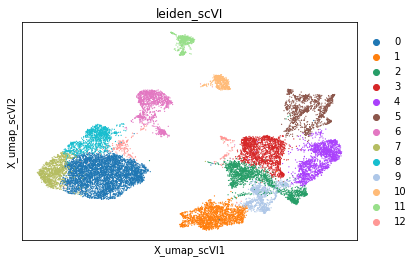

In [207]:
sc.pl.embedding(PCW6, 'X_umap_scVI', color=[  "leiden_scVI"],  size= 6, save= "pcw6_batchcorrection_scvi_leiden.png")

## Visualisation without batch correction (run_id) for PCW6

In [109]:
sc.tl.pca(PCW6)
sc.pp.neighbors(PCW6, use_rep="X_pca", key_added='PCA') #use_rep=any values from obsm
sc.tl.umap(PCW6,neighbors_key='PCA')
PCW6.obsm["X_umap_pca"] = PCW6.obsm["X_umap"].copy()
sc.tl.leiden(PCW6, key_added="leiden_pca", resolution=0.5, neighbors_key='PCA')

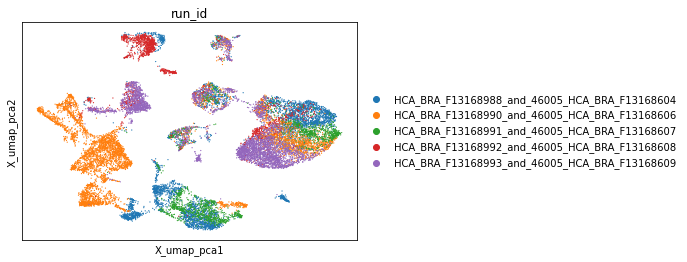

In [142]:
sc.pl.embedding(PCW6, 'X_umap_pca', color=[ "run_id"],  size= 6, save= "pcw6_nobatchcorrection_pca.png")

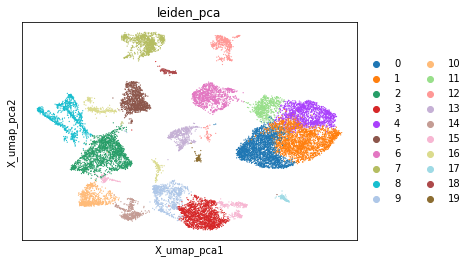

In [143]:
sc.pl.embedding(PCW6, 'X_umap_pca', color=[ "leiden_pca"],  size= 6, save= "pcw6_nobatchcorrection_pca_leiden.png")

### look at broad cell type markers 

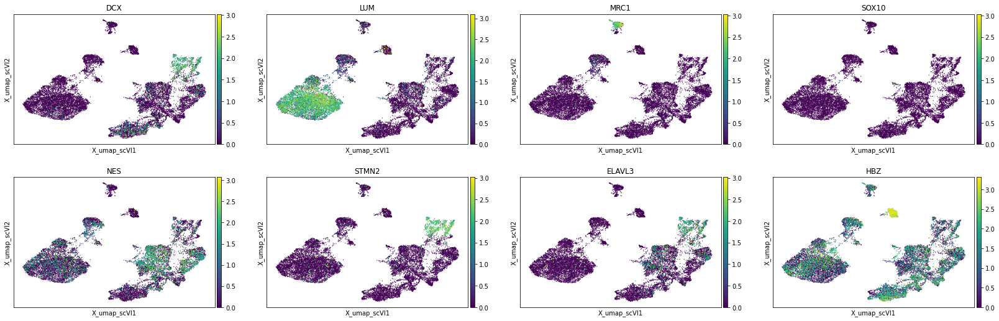

In [141]:
sc.pl.embedding(PCW6, 'X_umap_scVI', color=[  "DCX", "LUM", "MRC1","SOX10","NES", "STMN2", "ELAVL3", "HBZ"],  size= 6, save="pcw6_cell_type_markers.png")

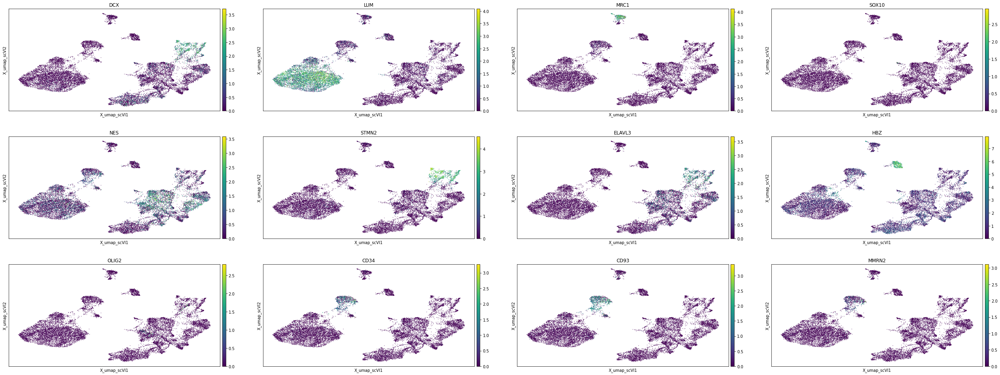

In [410]:
sc.pl.embedding(PCW6, 'X_umap_scVI', color=[  "DCX", "LUM", "MRC1","SOX10","NES", "STMN2", "ELAVL3", "HBZ", "OLIG2", "CD34", "CD93", "MMRN2"],  size= 6)

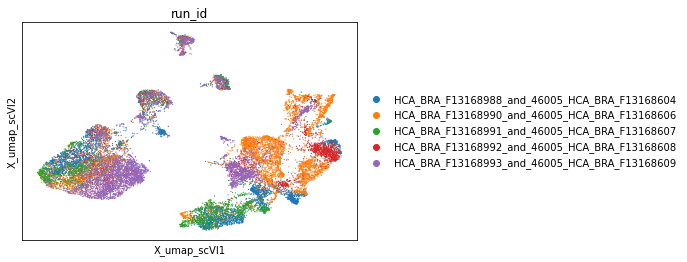

In [208]:
sc.pl.embedding(PCW6, 'X_umap_scVI', color=[ "run_id"],  size= 6)

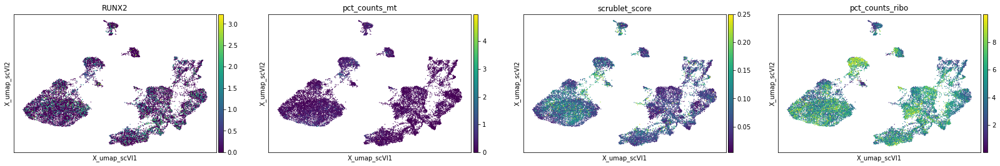

In [114]:
sc.pl.embedding(PCW6, 'X_umap_scVI', color=['RUNX2','pct_counts_mt','scrublet_score','pct_counts_ribo'],legend_loc='on data')

In [115]:
PCW6

AnnData object with n_obs × n_vars = 17892 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI', 'leiden_pca'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'X_scVI', 'umap', 'leiden', 'run_id_colors', 'leiden_scVI_colors', 'pca', 'PCA', 'leiden_pca_colors'
    obsm: 

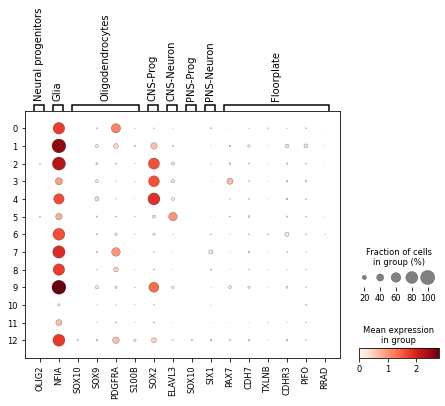

In [118]:
sc.pl.dotplot(PCW6,CNS_Markers, "leiden_scVI", dendrogram=False, use_raw=False)

## Make broad labels of cell typist for PCW6 to make visualisation easier 

In [54]:
PCW6.obs["broad_labels"]= PCW6.obs["predicted_labels"]

PCW6.obs['broad_labels'] = PCW6.obs['broad_labels'].astype("str")

for i in range(len(PCW6.obs["broad_labels"])):
    g=PCW6.obs["broad_labels"][i]
    my_list =  g.split(maxsplit=1)
    my_List_2= ":".join(my_list)
    label, sep, tail = my_List_2.partition(':')
    PCW6.obs["broad_labels"][i]= label

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


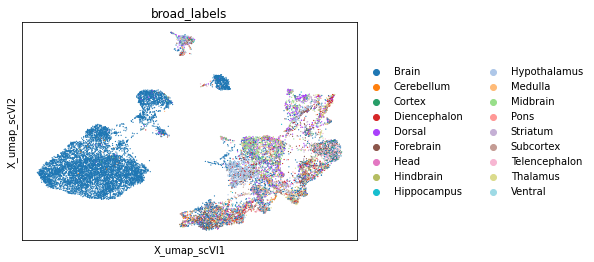

In [40]:
sc.pl.embedding(PCW6, 'X_umap_scVI', color=[ "broad_labels"],  size= 6)

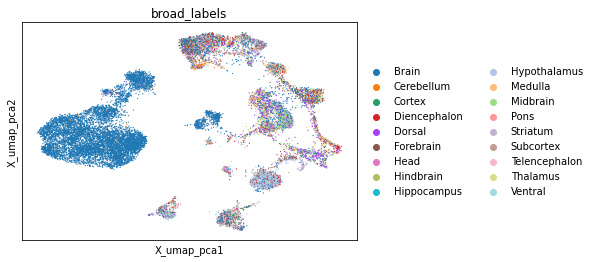

In [55]:
sc.pl.embedding(PCW6, 'X_umap_pca', color=[ "broad_labels"],  size= 6)

In [57]:
PCW6.obs["predicted_labels"].value_counts()[:60]

Brain fibroblasts              6080
Brain vascular cells           1589
Brain radial glia              1418
Brain erythrocytes             1081
Hypothalamus radial glia        835
Midbrain radial glia            633
Subcortex radial glia           615
Dorsal midbrain radial glia     566
Thalamus radial glia            523
Diencephalon radial glia        454
Forebrain radial glia           395
Telencephalon radial glia       374
Medulla radial glia             210
Dorsal midbrain neuroblast      204
Striatum radial glia            197
Forebrain neuron                138
Hypothalamus immune cells       128
Cerebellum radial glia          127
Forebrain glioblast             122
Forebrain neuroblast            117
Dorsal midbrain glioblast       111
Midbrain neuroblast             109
Dorsal midbrain neuron          102
Pons glioblast                  101
Hypothalamus neuroblast          99
Brain neuron                     98
Cortex radial glia               92
Brain neuronal IPC          

# Immune Cells at PCW6

In [119]:
Immune= ["Brain immune cells", "Forebrain immune cells", "Telencephalon immune cells",
        "Midbrain immune cells","Midbrain immune cells","Striatum immune cells",
        "Head immune cells","Hindbrain immune cells","Thalamus immune cells",
        "Cerebellum immune cells","Cortex immune cells","Medulla immune cells",
        "Pons immune cells","Hypothalamus immune cells","Ventral immune cells",
        "Dorsal immune cells","Subcortex immune cells","Hippocampus immune cells"
        ]
Immune_Subset= PCW6[PCW6.obs["predicted_labels"].isin(Immune)]

Immune_2= np.unique(Immune_Subset.obs['predicted_labels'])
Immune_3= list(set(Immune) & set(Immune_2))
Immune_3

['Hypothalamus immune cells',
 'Subcortex immune cells',
 'Midbrain immune cells',
 'Cortex immune cells',
 'Cerebellum immune cells',
 'Hippocampus immune cells',
 'Hindbrain immune cells',
 'Brain immune cells',
 'Striatum immune cells',
 'Thalamus immune cells',
 'Pons immune cells',
 'Forebrain immune cells']

In [120]:
(Immune_Subset.obs["predicted_labels"].value_counts())

Hypothalamus immune cells    128
Forebrain immune cells        44
Cortex immune cells           36
Hippocampus immune cells      18
Subcortex immune cells        13
Thalamus immune cells          8
Brain immune cells             6
Hindbrain immune cells         4
Midbrain immune cells          3
Striatum immune cells          3
Cerebellum immune cells        2
Pons immune cells              2
Name: predicted_labels, dtype: int64

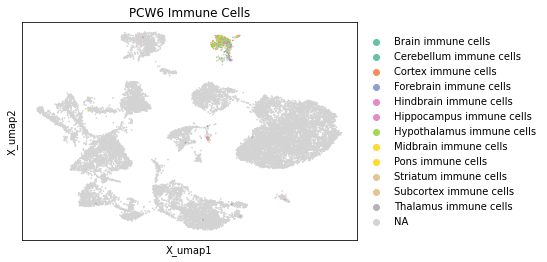

In [139]:
sc.pl.embedding(PCW6, 'X_umap', color=[ "predicted_labels"],  size= 12,
                groups=[Immune_3[0],Immune_3[1],Immune_3[2],Immune_3[3],Immune_3[4],Immune_3[5],Immune_3[6],Immune_3[7],Immune_3[8],
                        Immune_3[9],Immune_3[10],Immune_3[11] ], title="PCW6 Immune Cells", save= "pcw6_immune_cells_celltypist.png")

In [126]:
Immune_Subset

View of AnnData object with n_obs × n_vars = 267 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI', 'leiden_pca'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'X_scVI', 'umap', 'leiden', 'run_id_colors', 'leiden_scVI_colors', 'pca', 'PCA', 'leiden_pca_colors'
    

## Subcluster PCW6 Immune Cells 

In [137]:
scVI_leiden_clusters_pcw6= PCW6.obs["leiden_scVI"]

In [147]:
PCW6= full_adata[full_adata.obs["pcw"]==6.7].copy()

In [148]:
PCW6.obs["leiden_scVI"]= scVI_leiden_clusters_pcw6

In [152]:
PCW6.obs["leiden_scVI"].value_counts()

0     4504
1     1812
2     1664
3     1652
4     1605
5     1196
6     1132
7     1094
8     1054
9      918
10     475
11     468
12     318
Name: leiden_scVI, dtype: int64

In [153]:
PCW6_Immune= PCW6[PCW6.obs["leiden_scVI"]=="11"]
PCW6_Immune

View of AnnData object with n_obs × n_vars = 468 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'

In [154]:
PCW6_Immune.layers["counts"] = PCW6_Immune.X.copy() # preserve counts
sc.pp.normalize_total(PCW6_Immune, target_sum=1e4)
sc.pp.log1p(PCW6_Immune)
PCW6_Immune.raw = PCW6_Immune # freeze the state in `.raw`

In [155]:
PCW6_Immune

AnnData object with n_obs × n_vars = 468 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p'
    layers: 'counts'

In [156]:
scvi.model.SCVI.setup_anndata(
    PCW6_Immune,
    layer="counts",
    categorical_covariate_keys=["run_id"],
)

/opt/conda/lib/python3.7/site-packages/scvi/data/fields/_layer_field.py:79: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  f"{logger_data_loc} does not contain unnormalized count data. "


In [157]:
model_pcw6_immune = scvi.model.SCVI(PCW6_Immune)

In [158]:
model_pcw6_immune.train()

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/opt/conda/lib/python3.7/site-packages/pytorch_lightning/trainer/data_loading.py:433: UserWarning: The number of training samples (4) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  f"The number of training samples ({self.num_training_batches}) is smaller than the logging interval"


Epoch 1/400:   0%|          | 0/400 [00:00<?, ?it/s]

/opt/conda/lib/python3.7/site-packages/scvi/distributions/_negative_binomial.py:438: UserWarning: The value argument must be within the support of the distribution
  UserWarning,


Epoch 400/400: 100%|██████████| 400/400 [00:49<00:00,  8.05it/s, loss=4.03e+03, v_num=1]


In [178]:
model_pcw6_immune

SCVI Model with the following params: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, 
gene_likelihood: zinb, latent_distribution: normal
Training status: Trained

In [160]:
PCW6_Immune

AnnData object with n_obs × n_vars = 468 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI', '_scvi_batch', '_scvi_labels'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: '_scvi_extra_categorical_covs'
    layers: 'counts'

In [161]:
latent_pcw6_immune = model_pcw6_immune.get_latent_representation()
PCW6_Immune.obsm["X_scVI"] = latent_pcw6_immune 

In [162]:
PCW6_Immune

AnnData object with n_obs × n_vars = 468 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI', '_scvi_batch', '_scvi_labels'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: '_scvi_extra_categorical_covs', 'X_scVI'
    layers

In [163]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(PCW6_Immune, use_rep="X_scVI",  key_added='X_scVI')
sc.tl.umap(PCW6_Immune, min_dist=0.3, neighbors_key='X_scVI')
PCW6_Immune.obsm["X_umap_scVI"] = PCW6_Immune.obsm["X_umap"].copy()

In [164]:
sc.tl.leiden(PCW6_Immune, key_added="leiden_scVI_immune", resolution=0.5, neighbors_key='X_scVI')

In [165]:
PCW6_Immune

AnnData object with n_obs × n_vars = 468 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI', '_scvi_batch', '_scvi_labels', 'leiden_scVI_immune'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', '_scvi_uuid', '_scvi_manager_uuid', 'X_scVI', 'umap', 'leiden'
    obsm: '

In [397]:
PCW6_Immune

AnnData object with n_obs × n_vars = 468 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI', '_scvi_batch', '_scvi_labels', 'leiden_scVI_immune'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', '_scvi_uuid', '_scvi_manager_uuid', 'X_scVI', 'umap', 'leiden', 'run_id_co

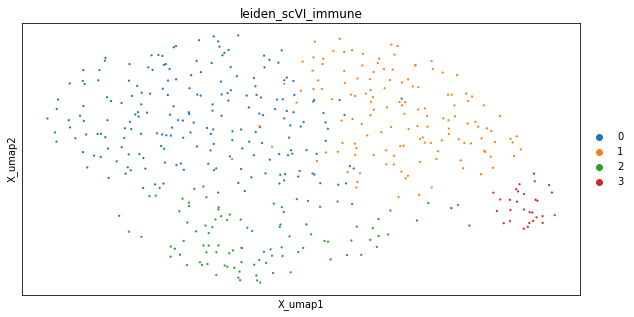

In [399]:
sc.pl.embedding(PCW6_Immune, 'X_umap', color=[ "leiden_scVI_immune"],  size= 20, save= "PCW6_Immune_subclustering.png")

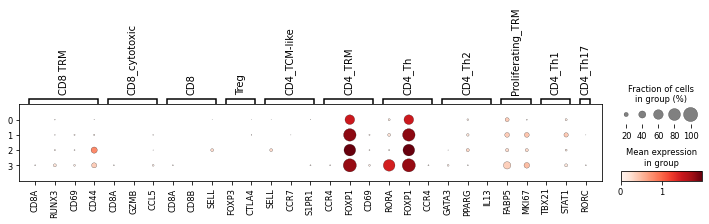

In [400]:
sc.pl.dotplot(PCW6_Immune,T_Cells, "leiden_scVI_immune", dendrogram=False, use_raw=False,  save= "PCW6_Immune_subclustering_TCells.png")

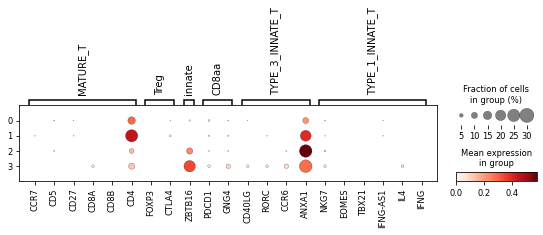

In [401]:
sc.pl.dotplot(PCW6_Immune,markers, "leiden_scVI_immune", dendrogram=False, use_raw=False, save= "PCW6_Immune_subclustering_MatureTCells.png")

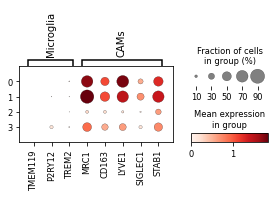

In [412]:
sc.pl.dotplot(PCW6_Immune,CAM_Markers, "leiden_scVI_immune", dendrogram=False, use_raw=False, save= "PCW6_Immune_subclustering_CAMCells.png")

# PCW8

In [131]:
PCW8.obs["compartment"].value_counts()

Mesenchyme     17337
Neural          6174
Immune          2100
Endothelial     1741
Erythroid        304
Name: compartment, dtype: int64

In [184]:
PCW8.layers["counts"] = PCW8.X.copy() # preserve counts
sc.pp.normalize_total(PCW8, target_sum=1e4)
sc.pp.log1p(PCW8)
PCW8.raw = PCW8 # freeze the state in `.raw`

In [185]:
scvi.model.SCVI.setup_anndata(
    PCW8,
    layer="counts",
    categorical_covariate_keys=["run_id"],
)

/opt/conda/lib/python3.7/site-packages/scvi/data/fields/_layer_field.py:79: UserWarning: adata.layers[counts] does not contain unnormalized count data. Are you sure this is what you want?
  f"{logger_data_loc} does not contain unnormalized count data. "


In [186]:
model_pcw8 = scvi.model.SCVI(PCW8)

In [187]:
model_pcw8

SCVI Model with the following params: 
n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, 
gene_likelihood: zinb, latent_distribution: normal
Training status: Not Trained

In [188]:
model_pcw8.train()

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/289:   0%|          | 0/289 [00:00<?, ?it/s]

/opt/conda/lib/python3.7/site-packages/scvi/distributions/_negative_binomial.py:438: UserWarning: The value argument must be within the support of the distribution
  UserWarning,


Epoch 289/289: 100%|██████████| 289/289 [31:33<00:00,  6.55s/it, loss=6.26e+03, v_num=1]


In [191]:
latent_pcw8 = model_pcw8.get_latent_representation()
PCW8.obsm["X_scVI"] = latent_pcw8 

In [192]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(PCW8, use_rep="X_scVI",  key_added='X_scVI')
sc.tl.umap(PCW8, min_dist=0.3, neighbors_key='X_scVI')
PCW8.obsm["X_umap_scVI"] = PCW8.obsm["X_umap"].copy()

In [193]:
PCW8

AnnData object with n_obs × n_vars = 27656 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', '_scvi_batch', '_scvi_labels'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', '_scvi_uuid', '_scvi_manager_uuid', 'X_scVI', 'umap'
    obsm: '_scvi_extra_categorical_covs', 'X_scVI', 'X_u

In [194]:
sc.tl.leiden(PCW8, key_added="leiden_scVI", resolution=0.5, neighbors_key='X_scVI')

In [195]:
PCW8.obs["broad_labels"]= PCW8.obs["predicted_labels"]

PCW8.obs['broad_labels'] = PCW8.obs['broad_labels'].astype("str")

for i in range(len(PCW8.obs["broad_labels"])):
    g=PCW8.obs["broad_labels"][i]
    my_list =  g.split(maxsplit=1)
    my_List_2= ":".join(my_list)
    label, sep, tail = my_List_2.partition(':')
    PCW8.obs["broad_labels"][i]= label

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  # Remove the CWD from sys.path while we load stuff.


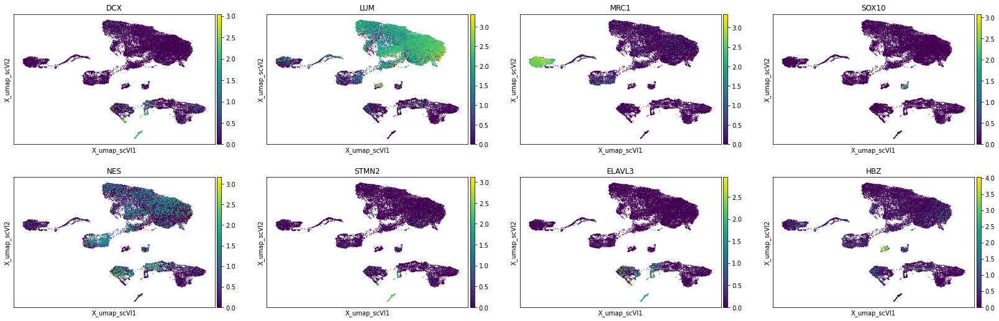

In [197]:
sc.pl.embedding(PCW8, 'X_umap_scVI', color=[  "DCX", "LUM", "MRC1","SOX10","NES", "STMN2", "ELAVL3", "HBZ"],  size= 6, save="pcw8_cell_type_markers.png")

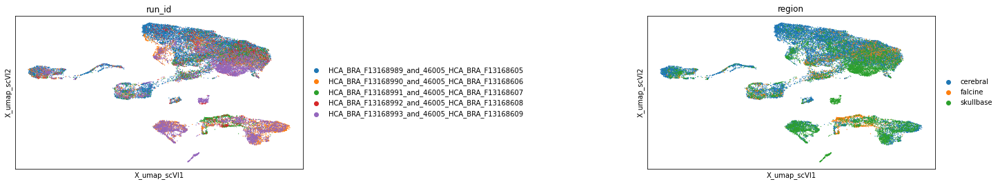

In [213]:
sc.pl.embedding(PCW8, 'X_umap_scVI', color=[  "run_id", "region"],  size= 6, wspace= 1)

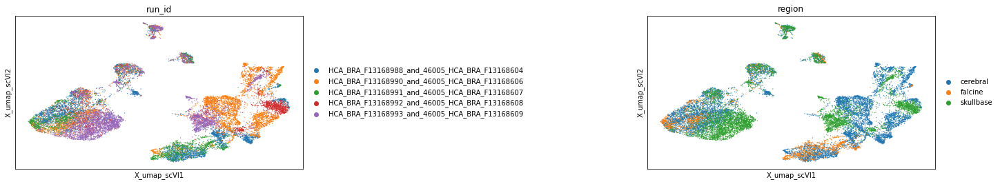

In [212]:
sc.pl.embedding(PCW6, 'X_umap_scVI', color=[  "run_id", "region"],  size= 6, wspace= 1)

# Joint Analysis of the two sections 

In [8]:
full_adata.layers["counts"] = full_adata.X.copy() # preserve counts
sc.pp.normalize_total(full_adata, target_sum=1e4)
sc.pp.log1p(full_adata)
full_adata.raw = full_adata # freeze the state in `.raw`

In [9]:
scvi.model.SCVI.setup_anndata(
    full_adata,
    layer="counts",
    categorical_covariate_keys=["run_id"],

)


Remote TPU is not linked into jax; skipping remote TPU.
Unable to initialize backend 'tpu_driver': Could not initialize backend 'tpu_driver'
Unable to initialize backend 'rocm': NOT_FOUND: Could not find registered platform with name: "rocm". Available platform names are: CUDA Interpreter Host
Unable to initialize backend 'tpu': module 'jaxlib.xla_extension' has no attribute 'get_tpu_client'
Unable to initialize backend 'plugin': xla_extension has no attributes named get_plugin_device_client. Compile TensorFlow with //tensorflow/compiler/xla/python:enable_plugin_device set to true (defaults to false) to enable this.


In [10]:
model_full_adata = scvi.model.SCVI(
    full_adata,
    n_hidden=512,
    n_layers=2,
    n_latent=50,
    gene_likelihood='nb',
    dispersion='gene-batch',
    use_observed_lib_size=False,
)
model_full_adata.train(
    train_size=0.99, 
    max_epochs=100, 
    batch_size=1024,
)

GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 100/100: 100%|██████████| 100/100 [13:49<00:00,  8.23s/it, loss=6.3e+03, v_num=1] 

`Trainer.fit` stopped: `max_epochs=100` reached.


Epoch 100/100: 100%|██████████| 100/100 [13:49<00:00,  8.30s/it, loss=6.3e+03, v_num=1]


In [11]:
latent_full = model_full_adata.get_latent_representation()
full_adata.obsm["X_scVI"] = latent_full

In [12]:
full_adata

AnnData object with n_obs × n_vars = 46578 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', '_scvi_batch', '_scvi_labels'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', '_scvi_uuid', '_scvi_manager_uuid'
    obsm: '_scvi_extra_categorical_covs', 'X_scVI'
    layers: 'counts'

In [13]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(full_adata, use_rep="X_scVI",  key_added='X_scVI')
sc.tl.umap(full_adata, min_dist=0.3, neighbors_key='X_scVI')
full_adata.obsm["X_umap_scVI"] = full_adata.obsm["X_umap"].copy()

In [14]:
full_adata

AnnData object with n_obs × n_vars = 46578 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', '_scvi_batch', '_scvi_labels'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', '_scvi_uuid', '_scvi_manager_uuid', 'X_scVI', 'umap'
    obsm: '_scvi_extra_categorical_covs', 'X_scVI', 'X_u

In [15]:
sc.tl.leiden(full_adata, key_added="leiden_scVI", resolution=0.5, neighbors_key='X_scVI')

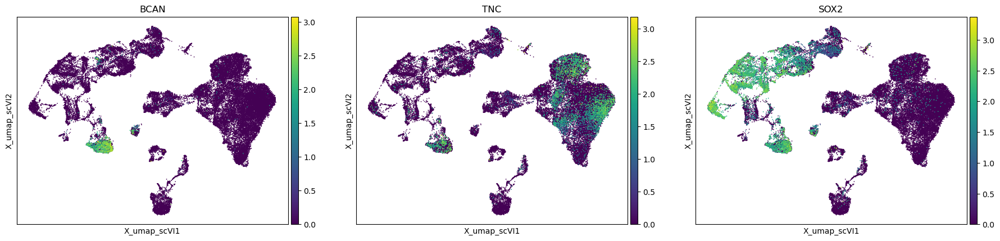

In [16]:
sc.pl.embedding(full_adata, 'X_umap_scVI', color=[  "BCAN", "TNC","SOX2"],  size= 6, save="combined_cell_type_markers.png")

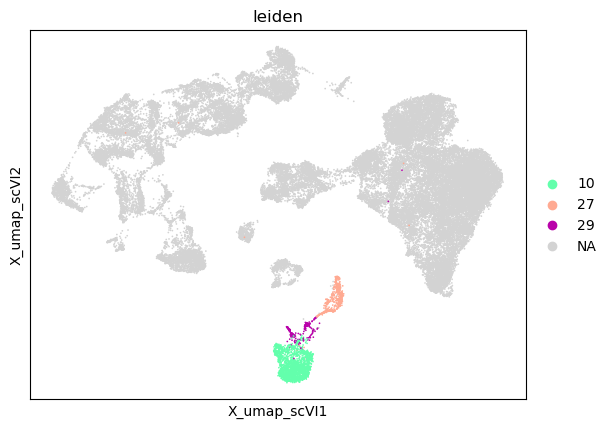

In [20]:
sc.pl.embedding(full_adata, 'X_umap_scVI', color=[  "leiden"],  size= 6, groups= ["10","27","29"])

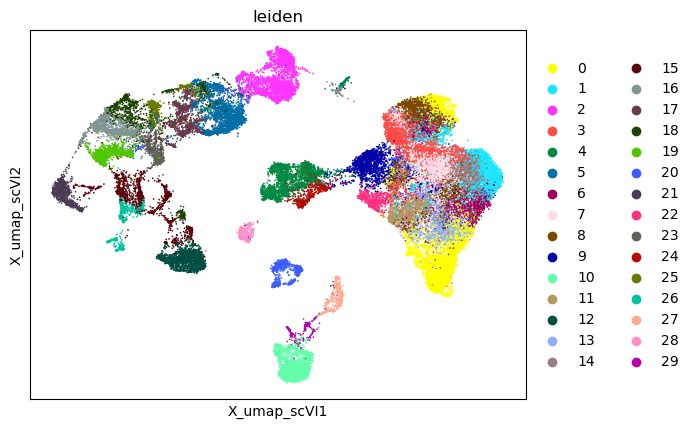

In [18]:
sc.pl.embedding(full_adata, 'X_umap_scVI', color=[  "leiden"],  size= 6, save="combined_cell_type_markers.png")

# annoration

In [21]:
correspondence= { "0": "Fibroblast", "1": "Fibroblast", "2": "Radial Glia", "3": "Fibroblast", "4": "Endothelial", "5": "Radial Glia", 
                 
                 "6": "Fibroblast", "7": "Fibroblast", "8": "Fibroblast", "9": "Fibroblast", "10": "Immune", "11": "Fibroblast", 
                   "12": "Glioblast", "13": "Fibroblast", "14": "Fibroblast","15": "Neuron","16": "Radial Glia",
                 
                 "17": "Radial Glia","18": "Radial Glia","19": "Neuron",
                 "20": "Erythrocyte","21": "Radial Glia","22": "Fibroblast",
                  "23": "Radial Glia","24": "Endothelial","25": "Radial Glia",
                 "26": "Neuron","27": "Immune","28": "OPC","29":"Immune"
                }

full_adata.obs['New_Annotation'] = full_adata.obs['leiden'].map(correspondence)



In [22]:
sc.set_figure_params(scanpy=True, fontsize=20)

... storing 'New_Annotation' as categorical


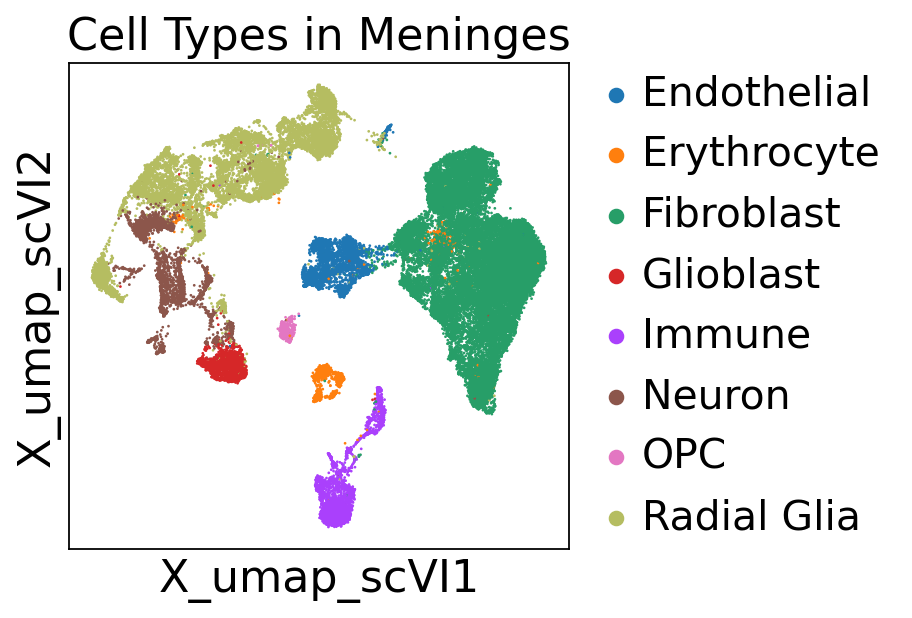

In [23]:
sc.pl.embedding(full_adata, 'X_umap_scVI', color=[ "New_Annotation"],  save= "Meninges_Celltypes.png",size= 6, vmin=1.0, cmap= "Reds", title= "Cell Types in Meninges")

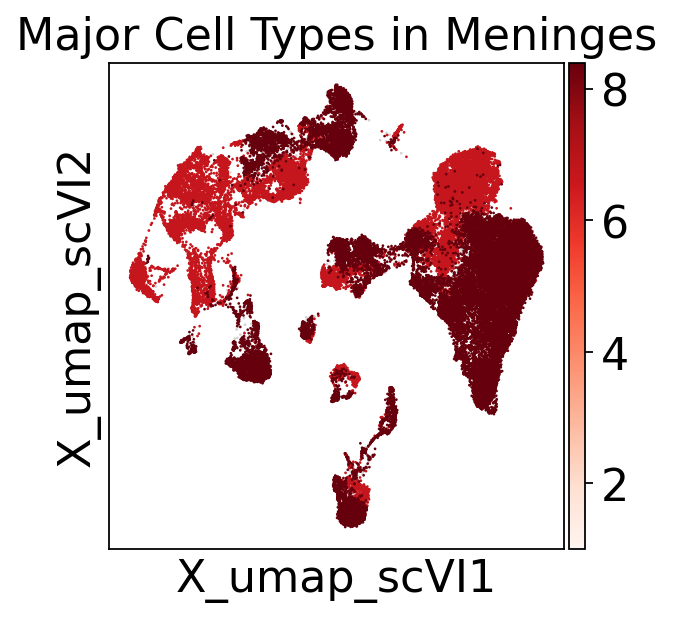

In [24]:
sc.pl.embedding(full_adata, 'X_umap_scVI', color=[ "pcw"],  size= 6, vmin=1.0, cmap= "Reds", title= "Major Cell Types in Meninges")

In [26]:
full_adata.write_h5ad("/home/jupyter/mount/gdrive/meninges/meninges_scvi_embedding_manual_annotation_2023_05_28.h5ad")

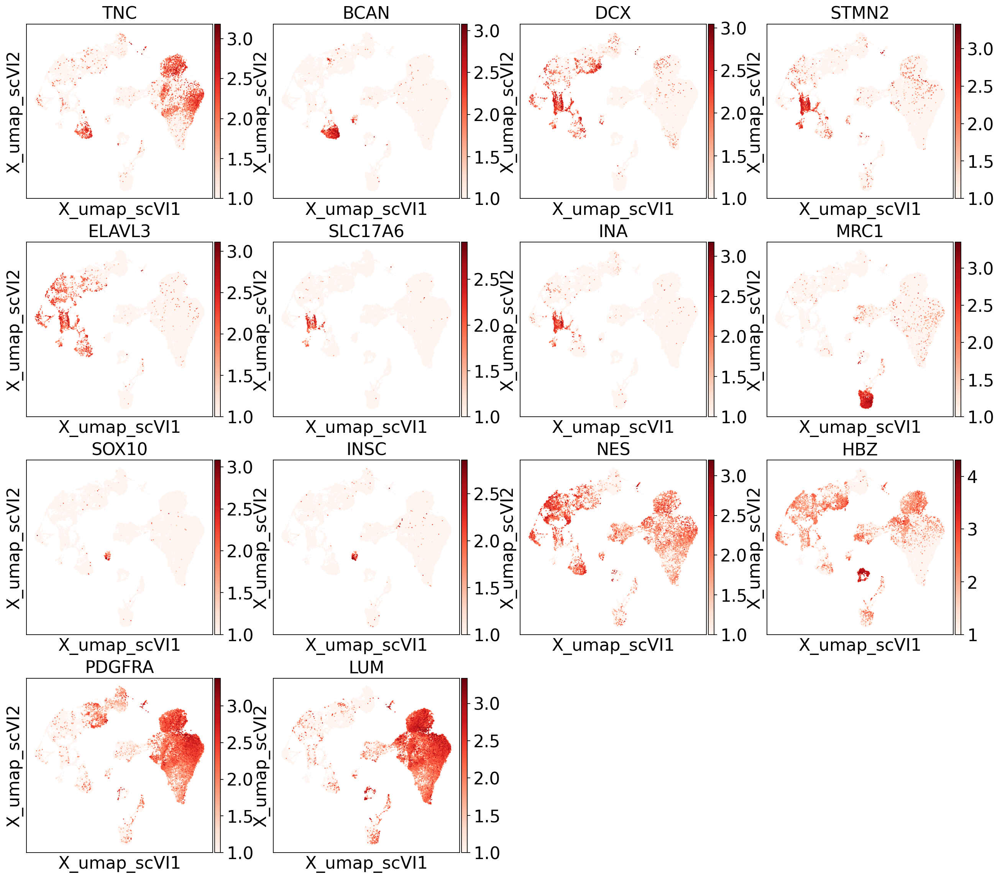

In [25]:
sc.pl.embedding(full_adata, 'X_umap_scVI', color=[ "TNC","BCAN", "DCX", "STMN2","ELAVL3", "SLC17A6", "INA", "MRC1","SOX10", "INSC","NES",  "HBZ", 'PDGFRA',"LUM"],  size= 6, save="combined_cell_type_markers.png", vmin=1.0, cmap= "Reds")

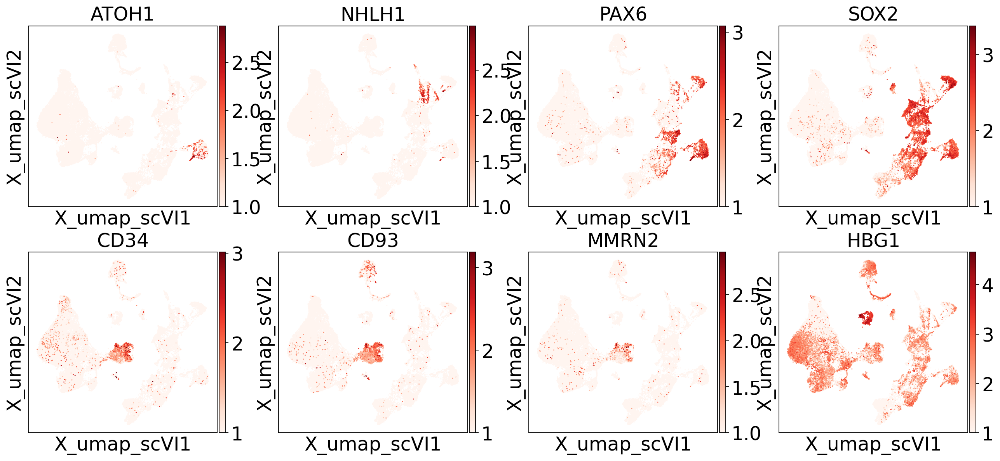

In [179]:
sc.pl.embedding(full_adata, 'X_umap_scVI', color=[  "ATOH1", "NHLH1", "PAX6", "SOX2", "CD34", "CD93", "MMRN2", "HBG1"],  size= 6, cmap= "Reds", vmin=1.0)

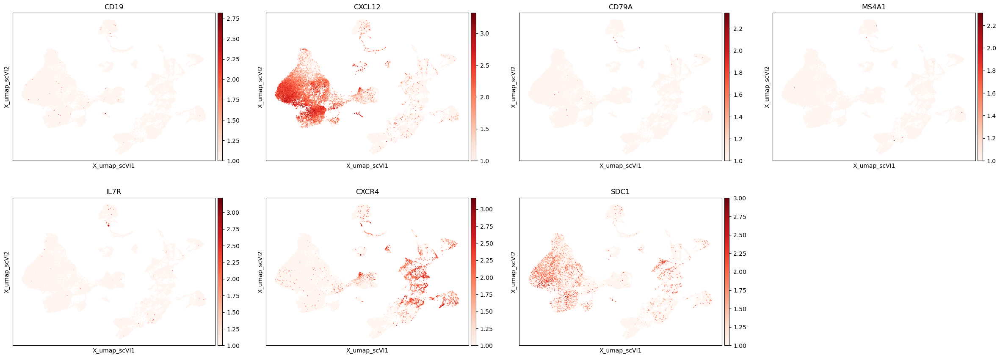

In [29]:
sc.pl.embedding(full_adata, 'X_umap_scVI', color=["CD19","CXCL12", "CD79A","MS4A1","IL7R","CXCR4","SDC1"  ],  size= 6, cmap= "Reds", vmin=1.0)

In [27]:
full_adata.obs["predicted_labels"]= full_adata.obs["predicted_labels"].astype("category")

In [29]:
full_adata.obs["pcw"]= full_adata.obs["pcw"].astype("category")

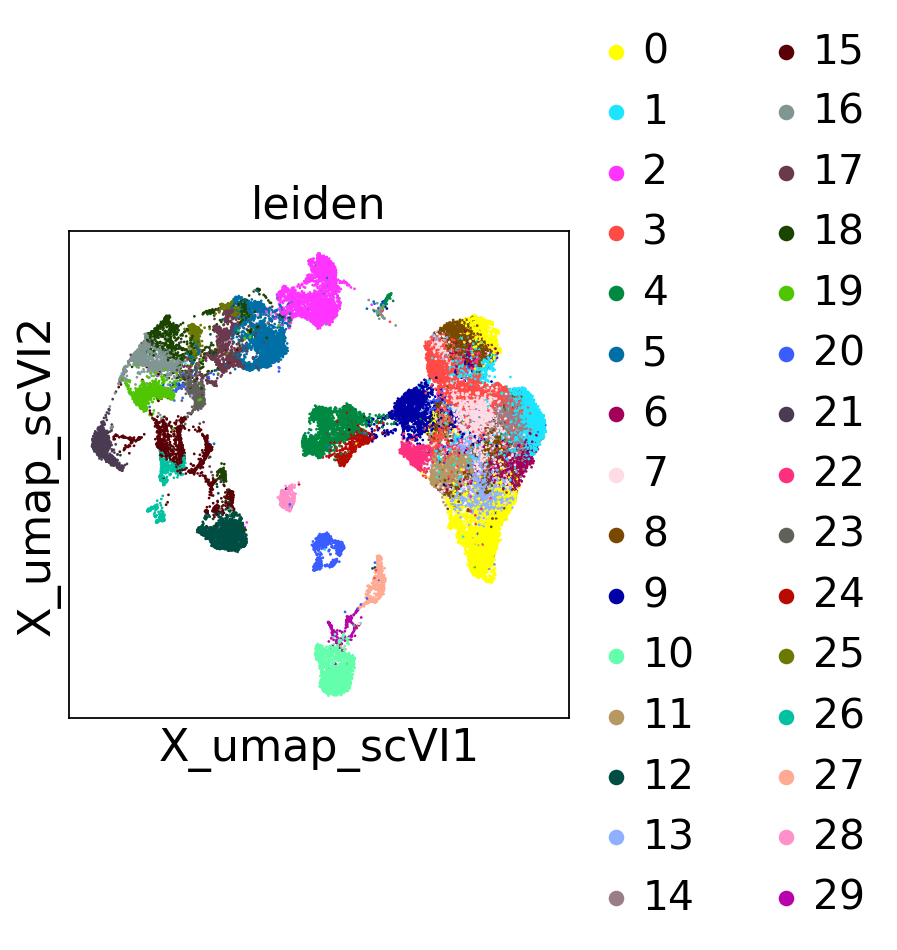

In [59]:
sc.pl.embedding(full_adata, 'X_umap_scVI', color=[  "leiden"],  size= 6, wspace=.75)

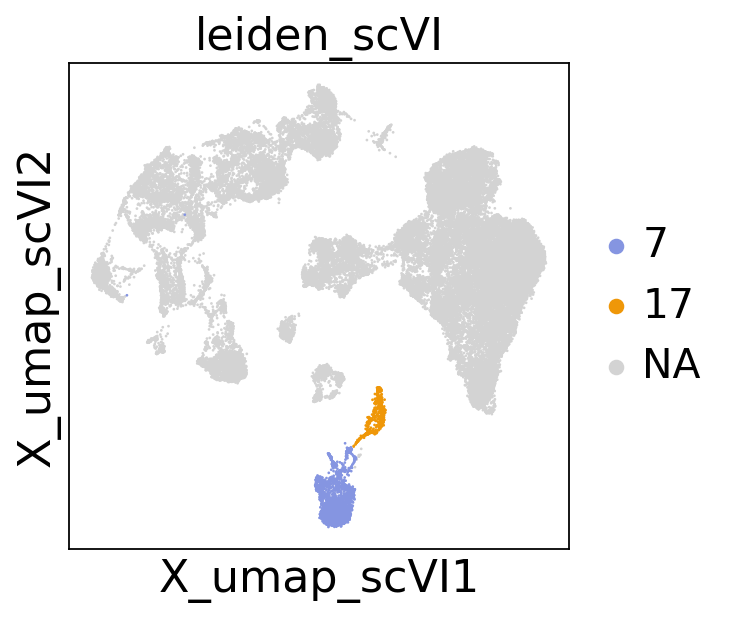

In [36]:
sc.pl.embedding(full_adata, 'X_umap_scVI', color=[  "leiden_scVI"], groups=["17","7"], size= 6, wspace=.75)

In [322]:
# DE Analysis 

In [320]:
#full_adata.write_h5ad("/home/jupyter/mount/gdrive/meninges_scvi_embedding.h5ad")

# Immune Cell Subtypes 

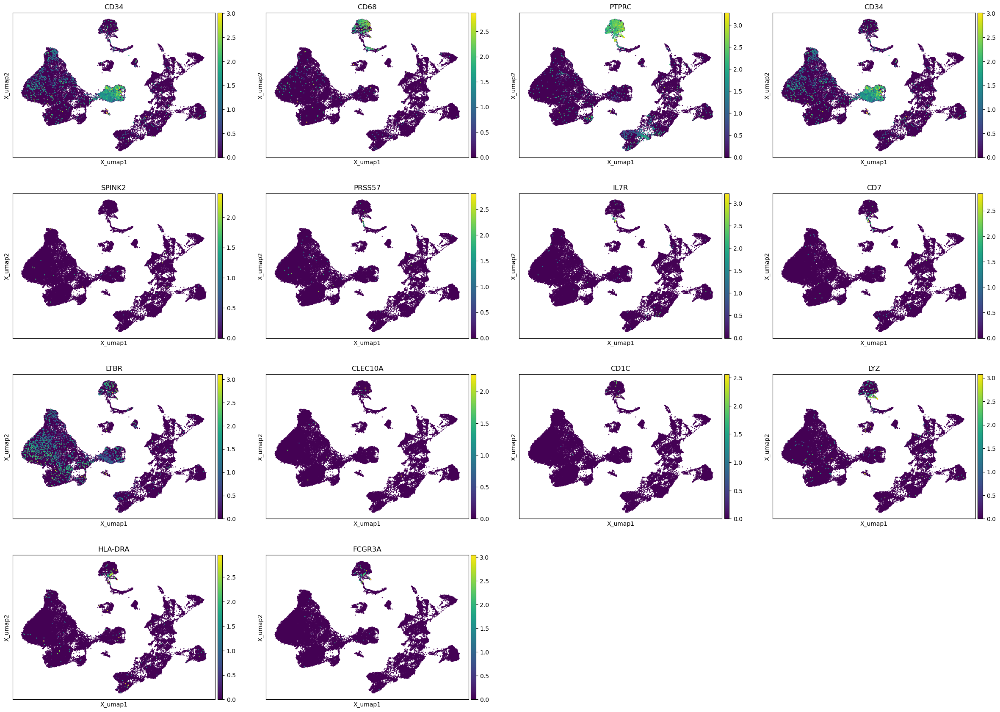

In [44]:
sc.pl.embedding(full_adata, 'X_umap', color=[ "CD34", "CD68", "PTPRC", "CD34", "SPINK2", "PRSS57", "IL7R", "CD7",
                                                    "LTBR", "CLEC10A", "CD1C", "LYZ","HLA-DRA", "FCGR3A"],  size= 12,  legend_loc="on data")

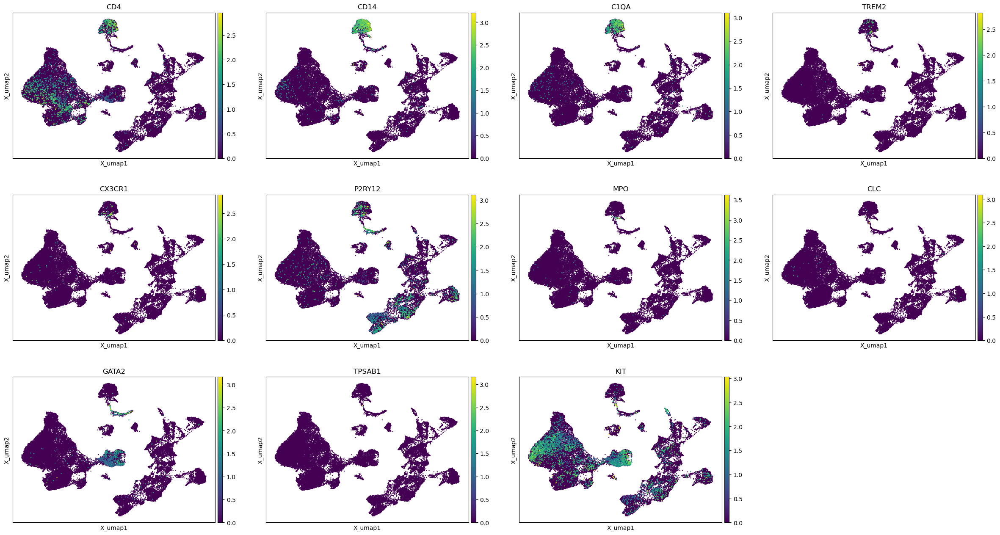

In [45]:
sc.pl.embedding(full_adata, 'X_umap', color=[  "CD4", "CD14","C1QA","TREM2","CX3CR1","P2RY12", "MPO", "CLC", "GATA2","TPSAB1","KIT"],  size= 12,  legend_loc="on data")

In [333]:
#sc.tl.leiden(adata_copy, restrict_to=['orig_leiden',["10",]], key_added="Immune", resolution=0.2)

In [37]:
adata_with_raw_counts= sc.AnnData(dataset.raw.X,obs=dataset.obs,var=dataset.raw.var)

In [42]:
adata_with_raw_counts.obs["leiden_scVI"]= full_adata.obs["leiden_scVI"].copy()
adata_with_raw_counts.obs["leiden_"]= full_adata.obs["leiden"].copy()
adata_with_raw_counts.obs["New_Annotation"]= full_adata.obs["New_Annotation"].copy()

In [43]:
adata_with_raw_counts

AnnData object with n_obs × n_vars = 46578 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI', 'leiden_', 'New_Annotation'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'

In [61]:
Immune_Subset= adata_with_raw_counts[adata_with_raw_counts.obs["leiden_scVI"].isin(["7","17"])]

In [57]:
#Immune_Subset= adata_with_raw_counts[adata_with_raw_counts.obs["leiden"].isin(["10","27","29"])]

In [52]:
#Immune_Subset= adata_with_raw_counts[adata_with_raw_counts.obs["New_Annotation"]=="Immune"]

In [62]:
Immune_Subset

View of AnnData object with n_obs × n_vars = 2690 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI', 'leiden_', 'New_Annotation'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'

In [63]:
Immune_Subset_copy= Immune_Subset.copy()

In [64]:
Immune_Subset_copy

AnnData object with n_obs × n_vars = 2690 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI', 'leiden_', 'New_Annotation'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'

In [65]:
#sc.pp.filter_genes(Immune_subset, min_cells=3) filters out a lot of genes so commenting this out 
sc.pp.normalize_total(Immune_Subset, target_sum=1e4)
sc.pp.log1p(Immune_Subset)
#sc.pp.highly_variable_genes(adata_copy, min_mean=0.0125, max_mean=3, min_disp=0.5, subset=True)
sc.pp.scale(Immune_Subset, zero_center=False)
sc.pp.pca(Immune_Subset, svd_solver='arpack', zero_center=False)
sc.pp.neighbors(Immune_Subset, n_pcs=30)
sc.tl.umap(Immune_Subset)
sc.tl.leiden(Immune_Subset, resolution=.5)

In [69]:
Immune_Subset

AnnData object with n_obs × n_vars = 2690 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI', 'leiden_', 'New_Annotation'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
 

In [67]:
Immune_Subset.obs["pcw"]= Immune_Subset.obs["pcw"].astype("category")

In [68]:
Immune_Subset.obs["pcw"].value_counts()

8.4    2109
6.7     526
Name: pcw, dtype: int64

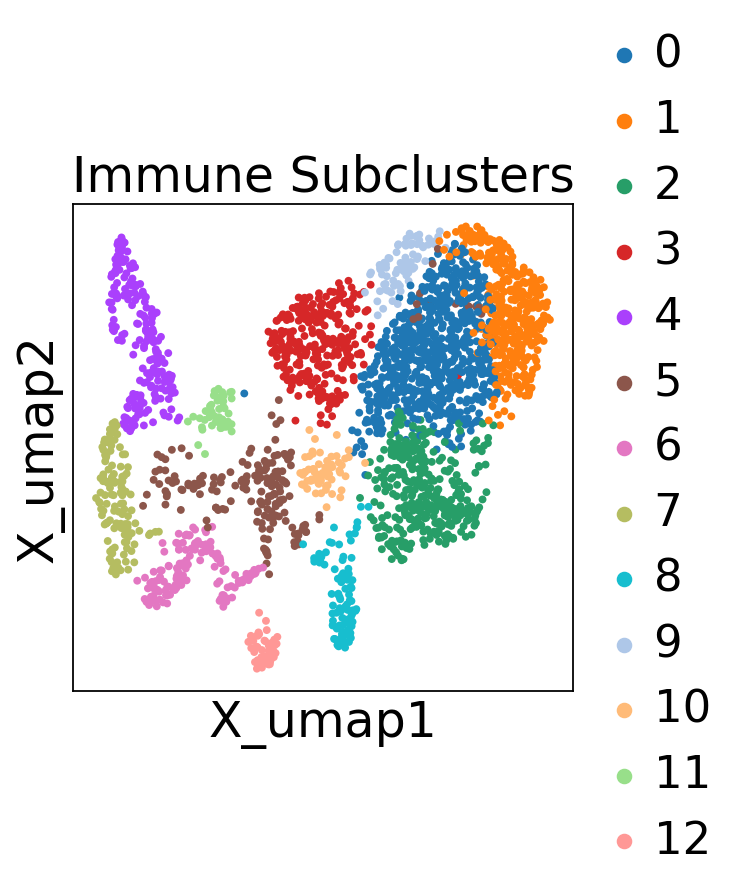

In [108]:
sc.pl.embedding(Immune_Subset, 'X_umap', color=[  "leiden"],  size= 50, save= "Immune_Cell_Subclustering.png", title= "Immune Subclusters")

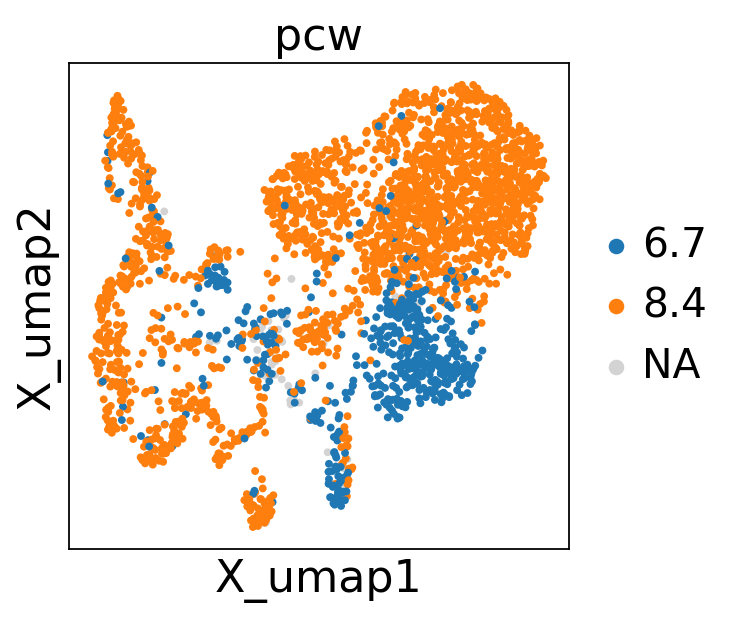

In [71]:
sc.pl.embedding(Immune_Subset, 'X_umap', color=[ "pcw"],  size= 50, save= "immune_cells_age_meninges.png")

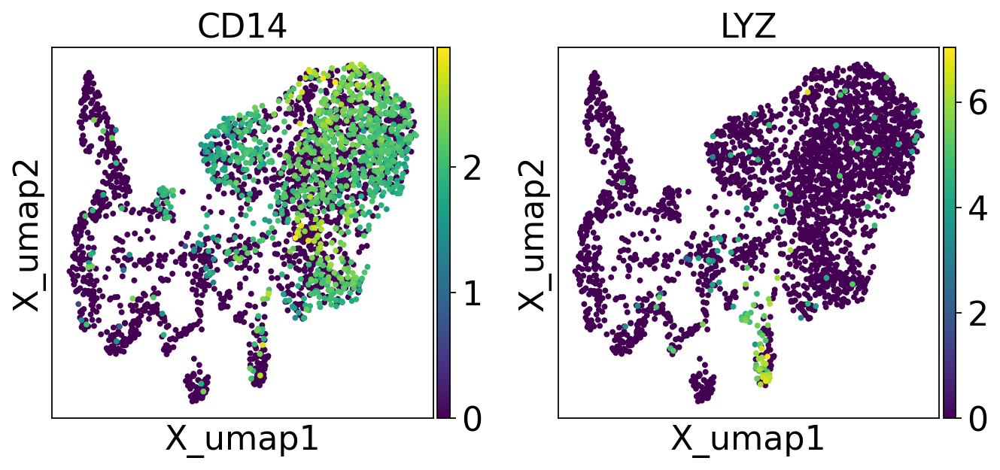

In [72]:
sc.pl.embedding(Immune_Subset, 'X_umap', color=[ "CD14", "LYZ"],  size= 50)

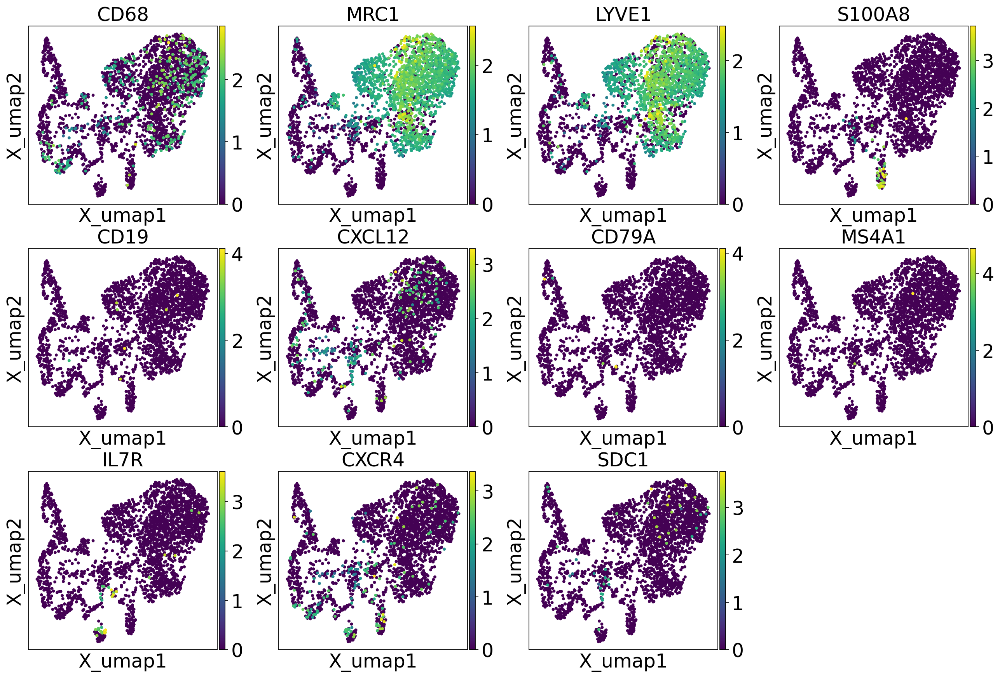

In [109]:
sc.pl.embedding(Immune_Subset, 'X_umap', color=[ "CD68", "MRC1","LYVE1", "S100A8","CD19","CXCL12", "CD79A","MS4A1","IL7R","CXCR4","SDC1"],  size= 50)

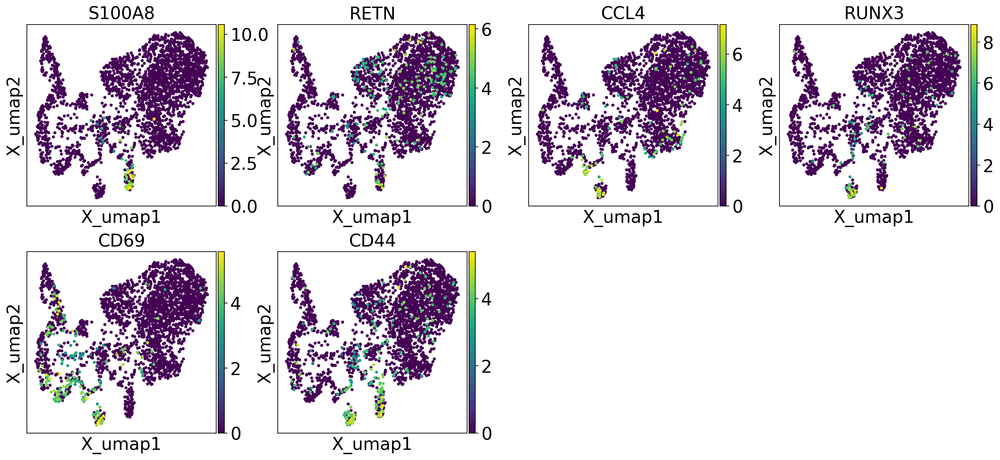

In [74]:
sc.pl.embedding(Immune_Subset, 'X_umap', color=[  "S100A8", "RETN", "CCL4","RUNX3","CD69","CD44"],  size= 50)

In [76]:
Immune_Subset.obs["pcw"].unique()

[6.7, 8.4, NaN]
Categories (2, float64): [6.7, 8.4]

# Immune Dotplots 

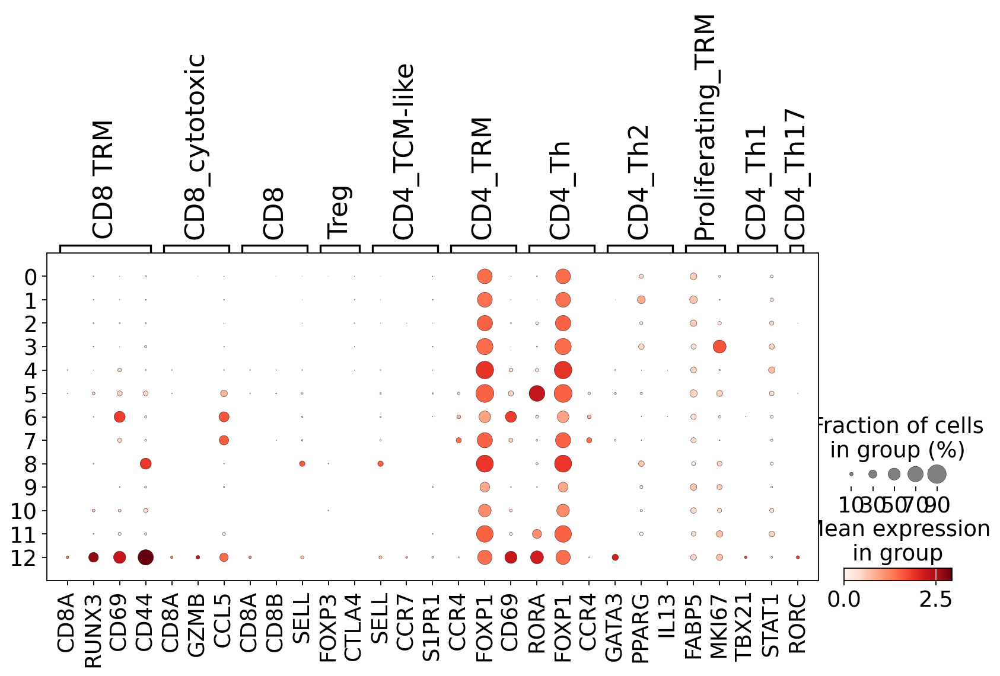

In [77]:
sc.pl.dotplot(Immune_Subset,T_Cells, "leiden", dendrogram=False, use_raw=False, save= "Immune_T_Cells.png")

In [111]:
progenitor_markers_panfetal = {'HSC_MPP':['CLEC9A','HLF','CD34','SPINK2'],
           'MLP':['BCL11A','IL7R','IL2RG'],
           'B lineage':['CD19','VPREB1','PAX5'],
           'T lineage':['CD3D','BCL11B'],
           'MEMP':['GATA2'],
           'MEP':['KLF1','ITGA2B'],
           'Ery lineage':['HBB','HBG1'],
           'Myeloid lineage':['MPO','CSF1R','CEBPA']
          }
myeloid_markers_panfetal = {'Early Progenitor':["CD34",	"SPINK2",	"MLLT3"],
'Myeloid_progenitor':["PRSS57",	"PRTN3",	"AZU1",],
'Neutrophil lineage':["ELANE",	"DEFA4",	"LCN2",	"LTF",	"ORM1",],
'Monocyte_lineage':["CD52",	"S100A8",	"MS4A6A",	"CD14",	"CXCR4",	"CCR2",	"IL1B",	"CD300E",],
'DC_progenitor':["ACY3",	"TIFAB",	"KIF17",],
'pDC':["CLEC4C",	"JCHAIN",	"IRF7",],
'ASDC':["SIGLEC6",	"AXL",],
'DC2':["CLEC10A",	"CD1C",],
'DC1':["CLEC9A",	"BATF3",],
'MIGRATORY_DC':["CCR7",	"LAMP3",],
'LANGERHANS_CELLS':["IDO1","CD207",	"CD1A",],
'EO_BASO_MAST':["CLC",	"KIT",	"TPSAB1",],
'MAC_LYVE1_HIGH':["F13A1",	"LYVE1",	"SPP1"],
 'MAC_IRON_RECYCLING':["CD5L",	"APOE",	"VCAM1",],
 'MAC_PROLIFERATING':["TOP2A",	"MKI67",],
 'MAC_MHCII_HIGH':["HLA-DRA",	"HLA-DPA1",	"CLEC7A",],
 'MAC_KUPFFER_LIKE':["ENG",	"KDR",	"CAV1",],
#'MAC_PERI':["SPP1","OLFML3","CCL3"],
#'MAC_ERY':['HBA1','HBA2','HBG2'],
 'MAC_TREM2':["TREM2",	"P2RY12",],
    'MAC_TLF+':["TIMD4", "FOLR2", 'LYVE1'],
'OSTEOCLAST':["MMP9",	"ACP5",]
          }
b_markers_panfetal = {'lymphoid progenitor':['CD34','SPINK2','IL7R','KIT'],
           'PRE PRO B':['FLT3','CD19','VPREB1'], 
           'PRO B':['MME','CDC45','DHFR','MKI67'], 
           'LATE PRO B':['CD27','RAG1','DNTT','VPREB3'], 
           'PRO -> PRE':['CD24','TNFRSF17'], 
           'PRE -> IMMATURE':['MME','IDH2','SPIB','IL4R'], 
           'MATURE':['MS4A1','CD40','FCER2'], 
           'B1':['CD27','SPN','CCR10'],
           'PLASMA B':['JCHAIN','SDC1','CD38'],
           'CYCLING_B':['MKI67']
          }

MEGA_ERY_markers_panfetal = {"Megakaryocyte Erythroid Precursors":['TESPA1','GATA2','FCER1A'],
"Early_ERY":['KLF1','APOE','FAM178B'],
"Mid_ERY":[ 'BLVRB', 'CD36', 'OAT',],
"Late_ERY":[ 'GYPA', 'GYPB', 'SLC4A1'],
"YS_ERY" : ['HBZ','HBE1'],
"Early_MK":['HBD','PF4'],
"late_MK":['ITGA2B','ITGB3','CLK1'],
"VSMC_PERICYTE_III":['PDGFRA', 'TAGLN','RGS5'],
'MACROPHAGE_ERY':["C1QA","CD163"],
"Proliferating" : ["TOP2A","MKI67"],
          }


Immune_Markers_Combined= { 
    'Ery lineage':['HBB','HBG1'],
           'Myeloid lineage':['MPO','CSF1R','CEBPA'],
    'Monocyte_lineage':["CD52",	"S100A8",	"MS4A6A",	"CD14",	"CXCR4",	"CCR2",	"IL1B",	"CD300E",],
    
    "EOS/Neutrophil":["CD69", "CD44" ,"S100A8","LYZ"],

    'PRE -> IMMATURE':['MME','IDH2','SPIB','IL4R'], 
    
    

    
     "Mid_ERY":[ 'BLVRB', 'CD36', 'OAT',],
                                           
                 

                 'Microglia':[ 'TMEM119','P2RY12',"TREM2","AIF1","CCL3"], # AIF1 & CCL3 from Trevino et al., 2021 
   
                  'CAMs': ['MRC1',"CD163", "LYVE1","SIGLEC1","STAB1","MS4A1"], # CNS Associated Macrophages
                 "Macrophage": ["CD4","CD14","C1QA"],
                        
                        "TREM2 Mac.": ["TREM2","CX3CR1"],
    
    'CD8 TRM' : ['CD8A', 'RUNX3', 'CD69', 'CD44', "CD3D"],
    "B/Plasma":["CD19","CXCL12", "CD79A","MS4A1","IL7R","CXCR4","SDC1"],
    "Late_ERY":[ 'GYPA', 'GYPB', 'SLC4A1'],
"Early_MK":['HBD','PF4'],
"late_MK":['ITGA2B','ITGB3','CLK1'],
    
    
    }

In [112]:
Immune_Subset

AnnData object with n_obs × n_vars = 2690 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'majority_voting', 'leiden_scVI', 'leiden_', 'New_Annotation', 'predicted_labels_old', 'over_clustering', 'conf_score'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'leide

In [113]:
sc.set_figure_params(scanpy=True, fontsize=22)

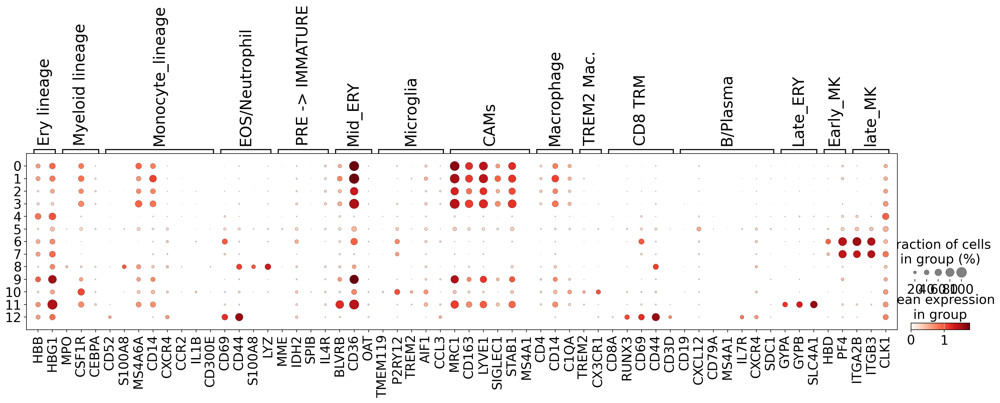

In [114]:
sc.pl.dotplot(Immune_Subset,Immune_Markers_Combined, "leiden", dendrogram=False, use_raw=False, save= "Joint_Immune_subclustering_MatureTCells.png")

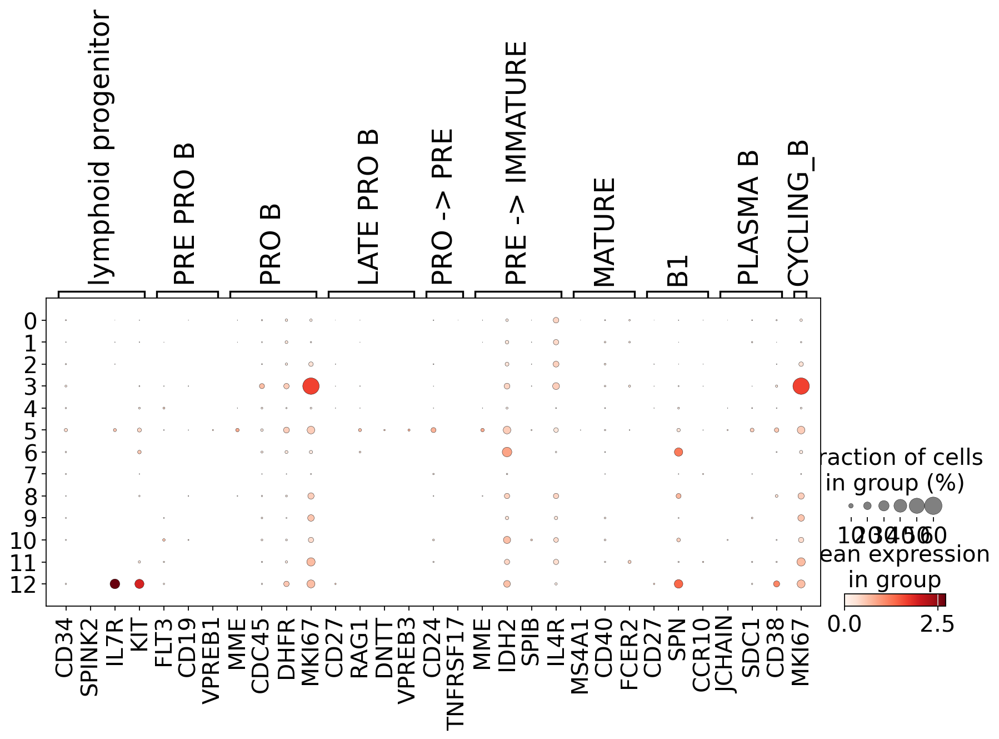

In [82]:
sc.pl.dotplot(Immune_Subset,b_markers_panfetal, "leiden", dendrogram=False, use_raw=False)

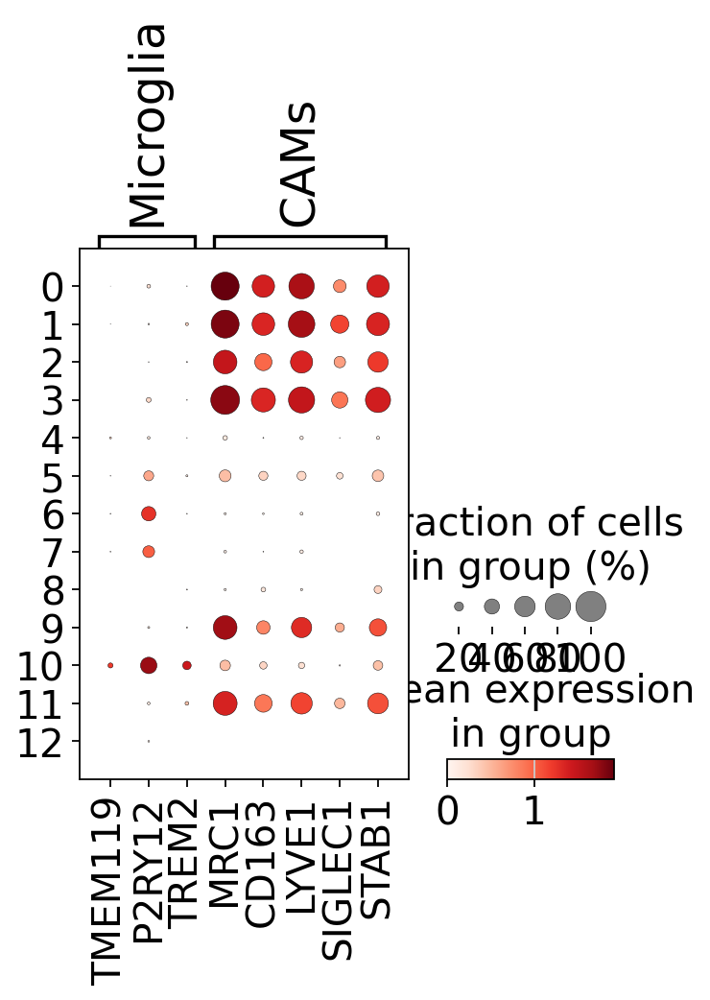

In [83]:
sc.pl.dotplot(Immune_Subset,CAM_Markers, "leiden", dendrogram=False, use_raw=False, save= "Joint_Immune_subclustering_CAM_MARKERS.png")

# Annotation of the immune compartment using the fetal immune dataset 

In [84]:
!wget https://cellgeni.cog.sanger.ac.uk/developmentcellatlas/fetal-immune/celltypist_model.Pan_Fetal_Human.pkl

--2023-05-28 01:59:36--  https://cellgeni.cog.sanger.ac.uk/developmentcellatlas/fetal-immune/celltypist_model.Pan_Fetal_Human.pkl
Resolving cellgeni.cog.sanger.ac.uk (cellgeni.cog.sanger.ac.uk)... 193.62.203.62, 193.62.203.63, 193.62.203.61
Connecting to cellgeni.cog.sanger.ac.uk (cellgeni.cog.sanger.ac.uk)|193.62.203.62|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4078788 (3.9M) [application/octet-stream]
Saving to: ‘celltypist_model.Pan_Fetal_Human.pkl.2’

celltypist_model.Pa 100%[===================>]   3.89M  --.-KB/s    in 0.09s   

2023-05-28 01:59:36 (44.2 MB/s) - ‘celltypist_model.Pan_Fetal_Human.pkl.2’ saved [4078788/4078788]



In [85]:
model = celltypist.models.Model.load(model = 'celltypist_model.Pan_Fetal_Human.pkl')

In [86]:
model.description                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                    

{'date': '2021-12-08 19:51:25.771934',
 'details': 'stromal and immune populations from the human fetus',
 'url': 'https://celltypist.cog.sanger.ac.uk/models/Pan_Fetal_Suo/Pan_Fetal_Human.pkl',
 'number_celltypes': 138}

In [87]:
model.cell_types

array(['ABT(ENTRY)', 'AS_DC', 'B1', 'CD4+T', 'CD8+T', 'CD8AA',
       'CHONDROCYTE', 'CMP', 'CYCLING_B', 'CYCLING_DC',
       'CYCLING_EPITHELIUM', 'CYCLING_FIBROBLAST_I',
       'CYCLING_FIBROBLAST_II', 'CYCLING_ILC', 'CYCLING_MEMP',
       'CYCLING_MPP', 'CYCLING_NK', 'CYCLING_PDC', 'CYCLING_T',
       'CYCLING_YS_ERY', 'DC1', 'DC2', 'DC_PROGENITOR',
       'DEVELOPING_NEPHRON_I', 'DEVELOPING_NEPHRON_II', 'DN(P)_T',
       'DN(Q)_T', 'DN(early)_T', 'DOUBLET', 'DOUBLETS_FIBRO_ERY',
       'DOUBLET_ENDOTHELIUM_ERYTHROCYTE', 'DOUBLET_ERY_B',
       'DOUBLET_IMMUNE_FIBROBLAST', 'DOUBLET_LYMPHOID_MACROPHAGE',
       'DOUBLET_VSMC_ERYTHROCYTE', 'DP(P)_T', 'DP(Q)_T', 'EARLY_ERY',
       'EARLY_MK', 'ENDOTHELIUM_I', 'ENDOTHELIUM_II', 'ENDOTHELIUM_III',
       'ENDOTHELIUM_IV', 'ENDOTHELIUM_V', 'ENTEROENDOCRINE_I',
       'ENTEROENDOCRINE_II', 'EOSINOPHIL_BASOPHIL', 'EPITHELIUM_I',
       'EPITHELIUM_II', 'FIBROBLAST_I', 'FIBROBLAST_II', 'FIBROBLAST_III',
       'FIBROBLAST_IV', 'FIBROBLAST_I

In [88]:
Immune_Subset.X.expm1().sum(axis = 1)

matrix([[3.3479206e+22],
        [4.9481553e+14],
        [7.8638266e+16],
        ...,
        [3.3479208e+22],
        [3.3479255e+22],
        [3.3479206e+22]], dtype=float32)

The expression matrix `query_adata.X` needs to be pre-processed as log1p normalised expression to 10,000 counts per cell.

In [89]:
sc.pp.normalize_per_cell(Immune_Subset, counts_per_cell_after=1e4)
sc.pp.log1p(Immune_Subset)

In [90]:
Immune_Subset.X.expm1().sum(axis = 1)

matrix([[ 9999.999],
        [10000.   ],
        [10000.   ],
        ...,
        [ 9999.999],
        [10000.   ],
        [10000.   ]], dtype=float32)

# Predict Cell Identity 

In [91]:
model.features

array(['TSPAN6', 'TNMD', 'DPM1', ..., 'AL513493.1', 'AC016831.7',
       'LINC00842'], dtype=object)

In [92]:
Immune_Subset.var

,name-0,name-1,name-2,name-3,name-4,name-5,n_cells,mt,ribo,hb,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,highly_variable,means,dispersions,dispersions_norm,mean,std
A1BG,A1BG,A1BG,A1BG,A1BG,A1BG,A1BG,716,False,False,False,716,0.008633,98.903018,563.466003,False,0.019519,1.396104,-0.579404,0.012185,0.152043
A1BG-AS1,A1BG-AS1,A1BG-AS1,A1BG-AS1,A1BG-AS1,A1BG-AS1,A1BG-AS1,510,False,False,False,510,0.007751,99.218630,505.926758,False,0.014822,1.396274,-0.578819,0.006452,0.109677
A1CF,A1CF,A1CF,A1CF,A1CF,A1CF,A1CF,96,False,False,False,96,0.001396,99.852919,91.139404,False,0.004486,1.593440,0.100470,0.000759,0.039342
A2M,A2M,A2M,A2M,A2M,A2M,A2M,13315,False,False,False,13315,0.773633,79.600123,50495.007812,True,0.627846,2.170554,1.009451,0.779680,1.011339
A2M-AS1,A2M-AS1,A2M-AS1,A2M-AS1,A2M-AS1,A2M-AS1,A2M-AS1,757,False,False,False,757,0.011561,98.840202,754.584534,False,0.027077,1.558011,-0.021593,0.008142,0.131582
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ZXDC,ZXDC,ZXDC,ZXDC,ZXDC,ZXDC,ZXDC,11536,False,False,False,11536,0.248511,82.325724,16220.333984,False,0.441754,1.629661,-0.258186,0.261648,0.674594
ZYG11A,ZYG11A,ZYG11A,ZYG11A,ZYG11A,ZYG11A,ZYG11A,353,False,False,False,353,0.005751,99.459170,375.390839,False,0.011028,1.566170,0.006518,0.001355,0.049788
ZYG11B,ZYG11B,ZYG11B,ZYG11B,ZYG11B,ZYG11B,ZYG11B,12340,False,False,False,12340,0.275237,81.093918,17964.748047,False,0.463310,1.596017,-0.370973,0.219055,0.625636
ZYX,ZYX,ZYX,ZYX,ZYX,ZYX,ZYX,7581,False,False,False,7581,0.142875,88.385169,9325.451172,False,0.223976,1.478620,-0.295116,0.204277,0.607813


In [93]:
Immune_Subset.var_names

Index(['A1BG', 'A1BG-AS1', 'A1CF', 'A2M', 'A2M-AS1', 'A2ML1', 'A2ML1-AS1',
       'A3GALT2', 'A4GALT', 'A4GNT',
       ...
       'ZW10', 'ZWILCH', 'ZWINT', 'ZXDA', 'ZXDB', 'ZXDC', 'ZYG11A', 'ZYG11B',
       'ZYX', 'ZZEF1'],
      dtype='object', length=31195)

In [94]:
predictions = celltypist.annotate(Immune_Subset, model = model, majority_voting=True)

🔬 Input data has 2690 cells and 31195 genes
🔗 Matching reference genes in the model
🧬 6705 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 5
🗳️ Majority voting the predictions
✅ Majority voting done!


In [95]:
Immune_Subset.obs["predicted_labels_old"]= Immune_Subset.obs["predicted_labels"]

In [96]:
Immune_Subset = predictions.to_adata()

In [97]:
n_cells = Immune_Subset.obs['majority_voting'].value_counts()
n_cells[0:60]

LATE_ERY                           2038
LATE_MK                             318
EARLY_MK                            115
MACROPHAGE_PERI                      65
LOW_QUALITY                          48
CYCLING_NK                           47
LOW_QUALITY_MID_ERY_(HIGH_RIBO)      41
HIGH_MITO                            18
Name: majority_voting, dtype: int64

In [98]:
pwd

'/home/jupyter/mount/gdrive/meninges'

... storing 'majority_voting' as categorical


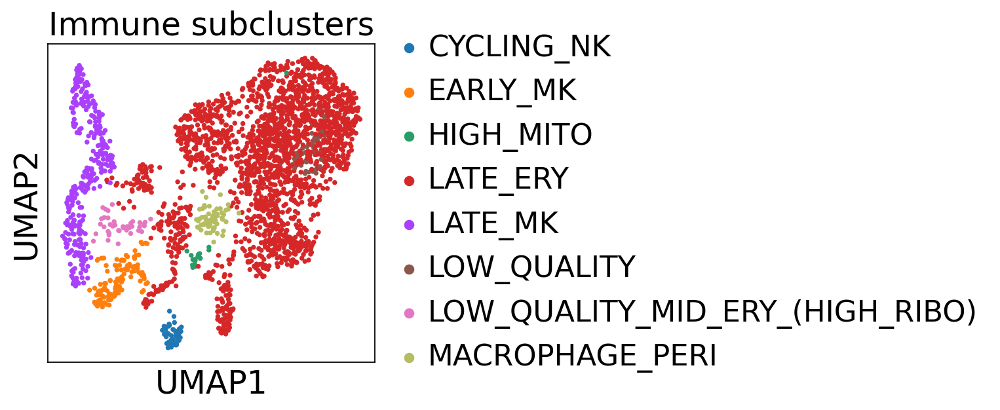

In [110]:
## Exclude low abundance predictions (if a label is given to less than 10 cells)
low_ab_predictions = n_cells.index[n_cells < 10]
Immune_Subset.obs['majority_voting'] = Immune_Subset.obs['majority_voting'].astype("str")
Immune_Subset.obs.loc[Immune_Subset.obs['majority_voting'].isin(low_ab_predictions), 'majority_voting'] = 'low_confidence'
sc.pl.umap(Immune_Subset, color=['majority_voting'], title= "Immune subclusters", save="Immune_Celltypist_panfetal.png")

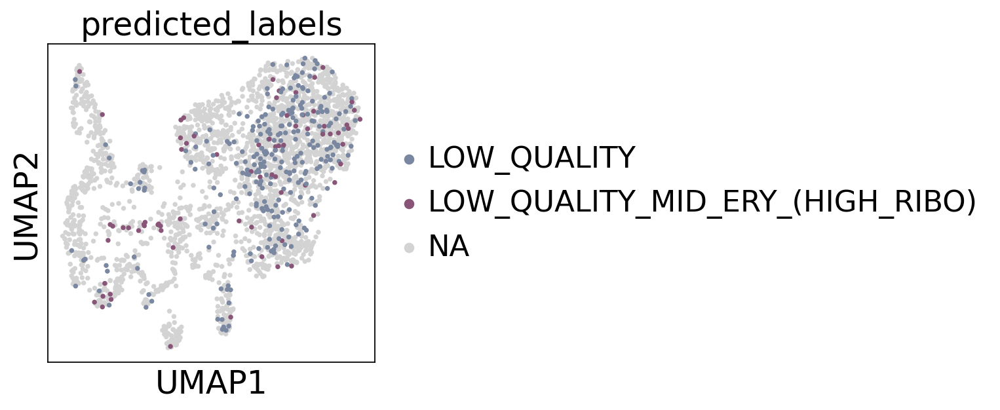

In [100]:
sc.pl.umap(Immune_Subset, color=['predicted_labels'], groups= ["LOW_QUALITY", "low_confidence", "LOW_QUALITY_MID_ERY_(HIGH_RIBO)"], save= "Low_quality_panfetal_immune.png")

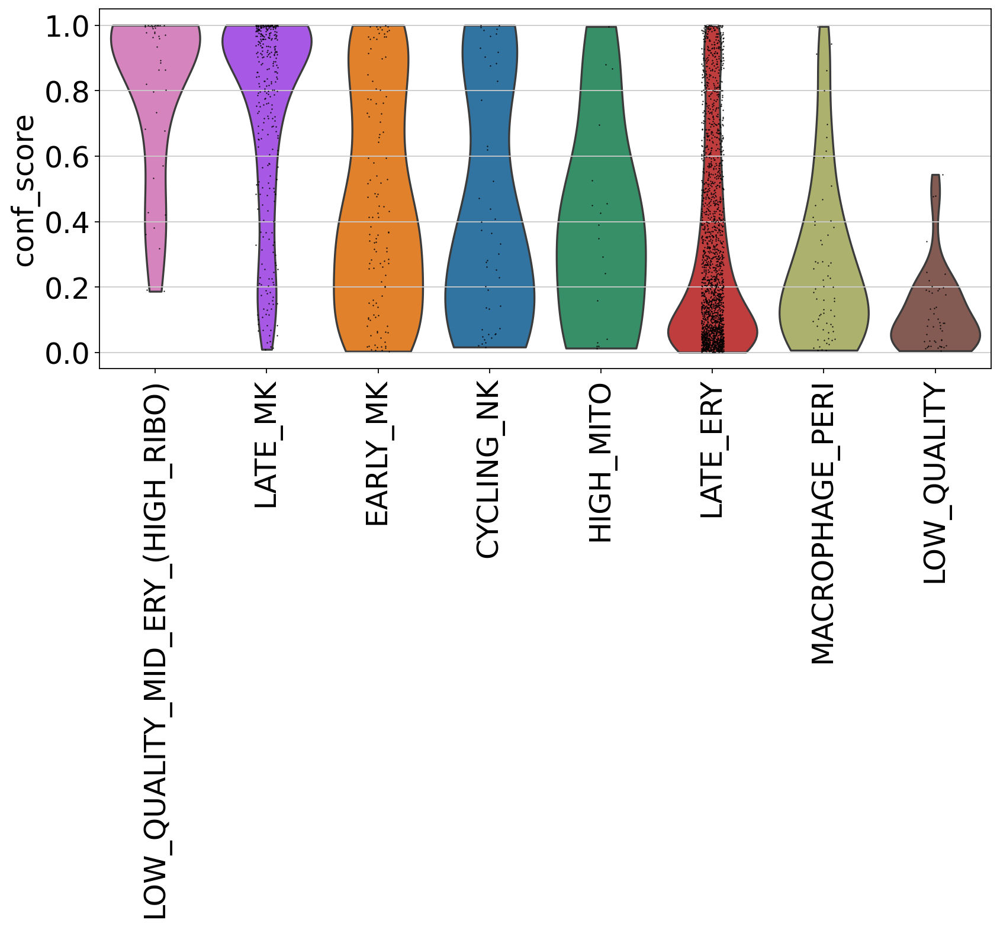

In [102]:
def _plot_sorted_violin(adata, groupby, y_value):
    n_cells_anno = adata.obs[[groupby,y_value]].value_counts(groupby)
    keep_anno = n_cells_anno.index[n_cells_anno > 3]

    mean_sim = adata.obs[[groupby,y_value]].groupby(groupby).mean()
    anno_order = mean_sim.loc[keep_anno].sort_values(y_value, ascending=False).index.tolist()

    adata.var_names_make_unique()
    sc.pl.violin(adata[adata.obs[groupby].isin(keep_anno)], 
                                     y_value, groupby=groupby, rotation=90, 
                                     order=anno_order, save= "violin.png")

plt.rcParams['figure.figsize'] = [10,5]
_plot_sorted_violin(Immune_Subset, y_value='conf_score', groupby='majority_voting')

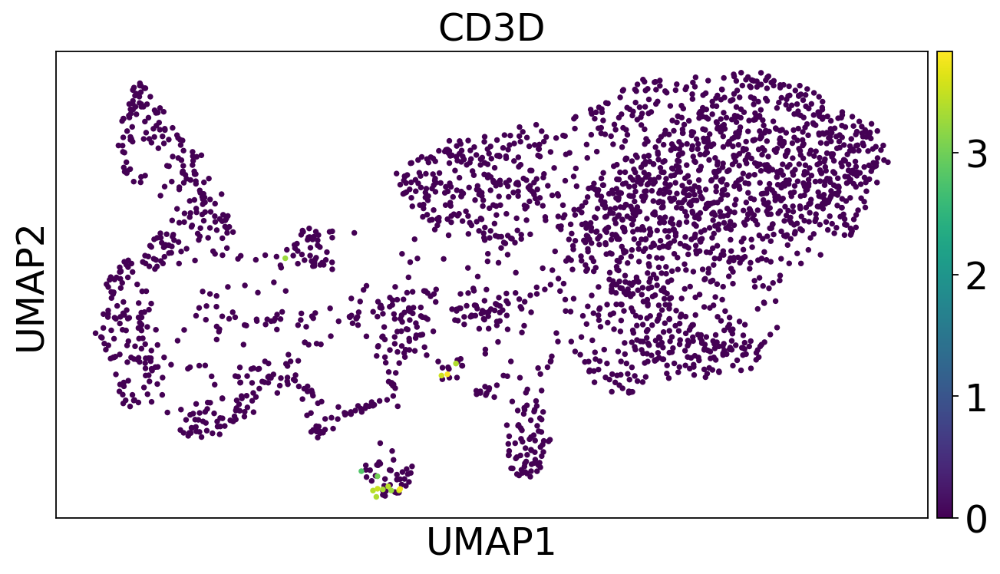

In [103]:
sc.pl.umap(Immune_Subset, color=['CD3D'],legend_loc='on data')

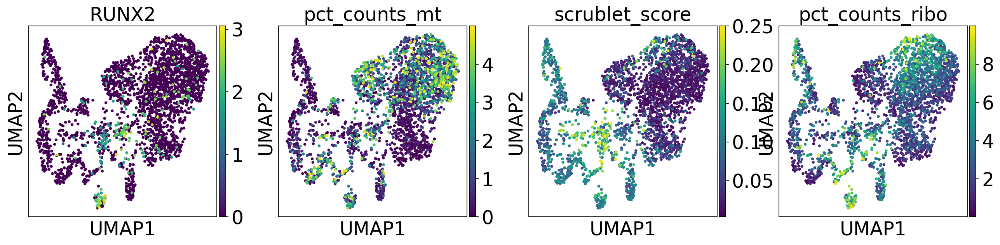

In [115]:
sc.pl.umap(Immune_Subset, color=['RUNX2','pct_counts_mt','scrublet_score','pct_counts_ribo'],legend_loc='on data')

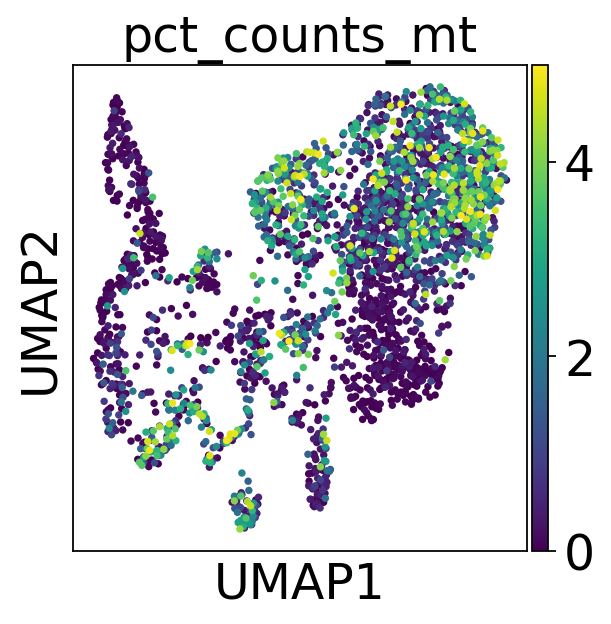

In [116]:
sc.pl.umap(Immune_Subset, color=['pct_counts_mt'],legend_loc='on data')

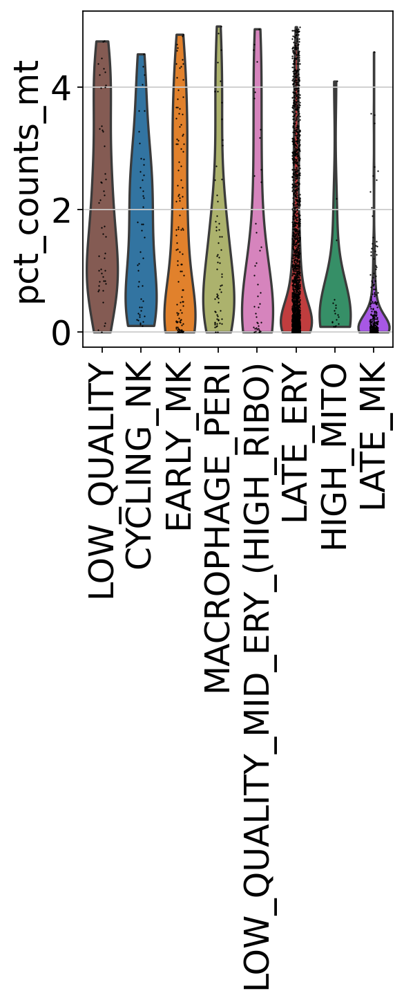

In [117]:
_plot_sorted_violin(Immune_Subset, y_value='pct_counts_mt', groupby='majority_voting')

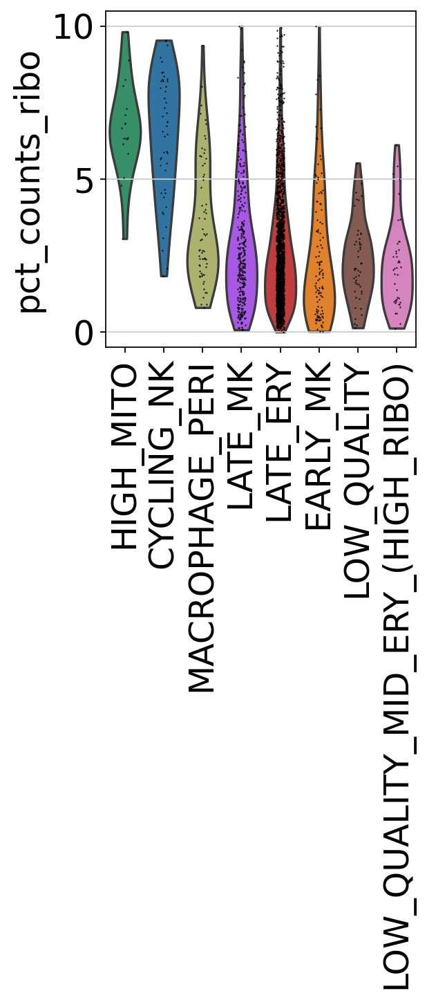

In [118]:
_plot_sorted_violin(Immune_Subset, y_value='pct_counts_ribo', groupby='majority_voting')

In [376]:
Immune_Subset

AnnData object with n_obs × n_vars = 2129 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'over_clustering', 'majority_voting', 'leiden_scVI', 'predicted_labels_old', 'conf_score'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'pcw_colors', 'leiden_colors', 'pre

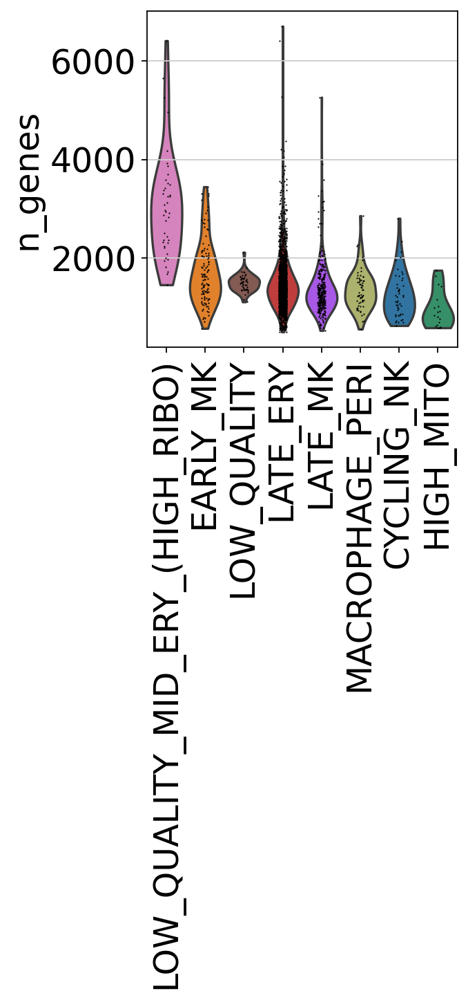

In [119]:
_plot_sorted_violin(Immune_Subset, y_value='n_genes', groupby='majority_voting')

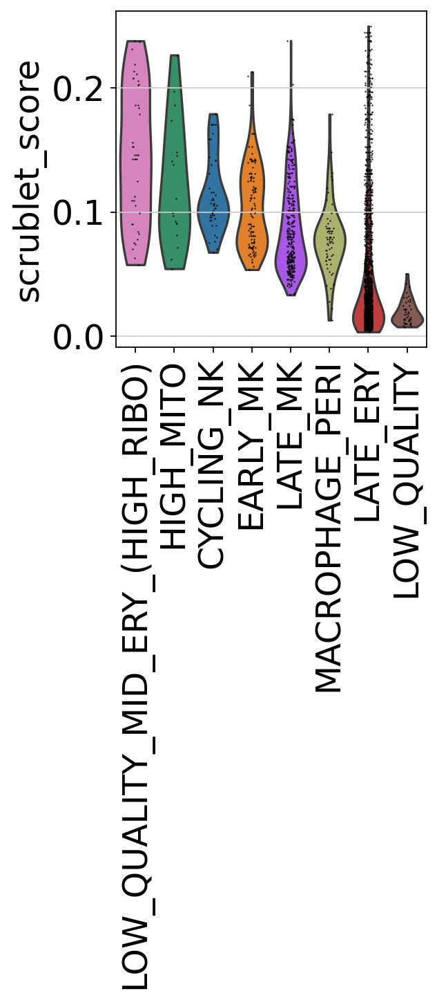

In [120]:
_plot_sorted_violin(Immune_Subset, y_value='scrublet_score', groupby='majority_voting')

In [383]:
list(Immune_Subset.obs["predicted_labels"].unique())

['LATE_ERY',
 'ILC3',
 'LOW_QUALITY',
 'YS_ERY',
 'PROMYELOCYTE',
 'HSC_MPP',
 'MACROPHAGE_MHCII_HIGH',
 'CD4+T',
 'HEPATOCYTE-LIKE',
 'MYELOCYTE',
 'FIBROBLAST_I',
 'MACROPHAGE_LYVE1_HIGH',
 'MONOCYTE_I_CXCR4',
 'MACROPHAGE_PROLIFERATING',
 'LOW_QUALITY_MID_ERY_(HIGH_RIBO)',
 'NK',
 'LMPP_MLP',
 'FIBROBLAST_XI',
 'LATE_MK',
 'low_confidence',
 'CYCLING_MEMP',
 'MACROPHAGE_TREM2',
 'FIBROBLAST_IV',
 'MONOCYTE_II_CCR2',
 'B1',
 'CMP',
 'MAST_CELL',
 'MOP',
 'CYCLING_NK',
 'MYOFIBROBLAST',
 'MACROPHAGE_PERI']

In [121]:
Immune_Subset.write_h5ad("/home/jupyter/mount/gdrive/meninges/meninges_immune_subset.h5ad")

In [122]:
Immune_Subset

AnnData object with n_obs × n_vars = 2690 × 31195
    obs: 'nCount_RNA', 'nFeature_RNA', 'run_id', 'batches', 'region', 'cranial_caudal', 'tentorium', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'batch', 'pcw', 'brc_code', 'percent_mito', 'percent_ribo', 'n_counts', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'QC', 'S_score', 'G2M_score', 'phase', 'leiden', 'compartment', 'predicted_labels', 'majority_voting', 'leiden_scVI', 'leiden_', 'New_Annotation', 'predicted_labels_old', 'over_clustering', 'conf_score'
    var: 'name-0', 'name-1', 'name-2', 'name-3', 'name-4', 'name-5', 'n_cells', 'mt', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'pca', 'neighbors', 'umap', 'leiden', 'leide

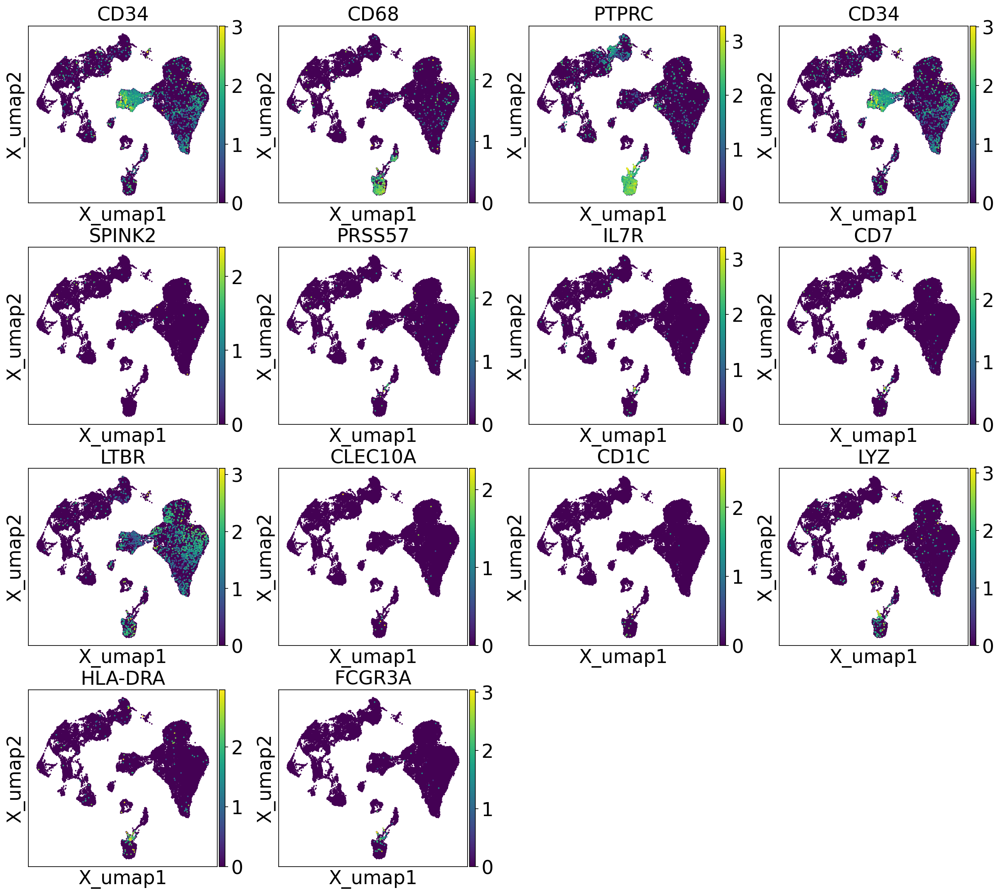

In [123]:
sc.pl.embedding(full_adata, 'X_umap', color=[ "CD34", "CD68", "PTPRC", "CD34", "SPINK2", "PRSS57", "IL7R", "CD7",
                                                    "LTBR", "CLEC10A", "CD1C", "LYZ","HLA-DRA", "FCGR3A"],  size= 12,  legend_loc="on data")

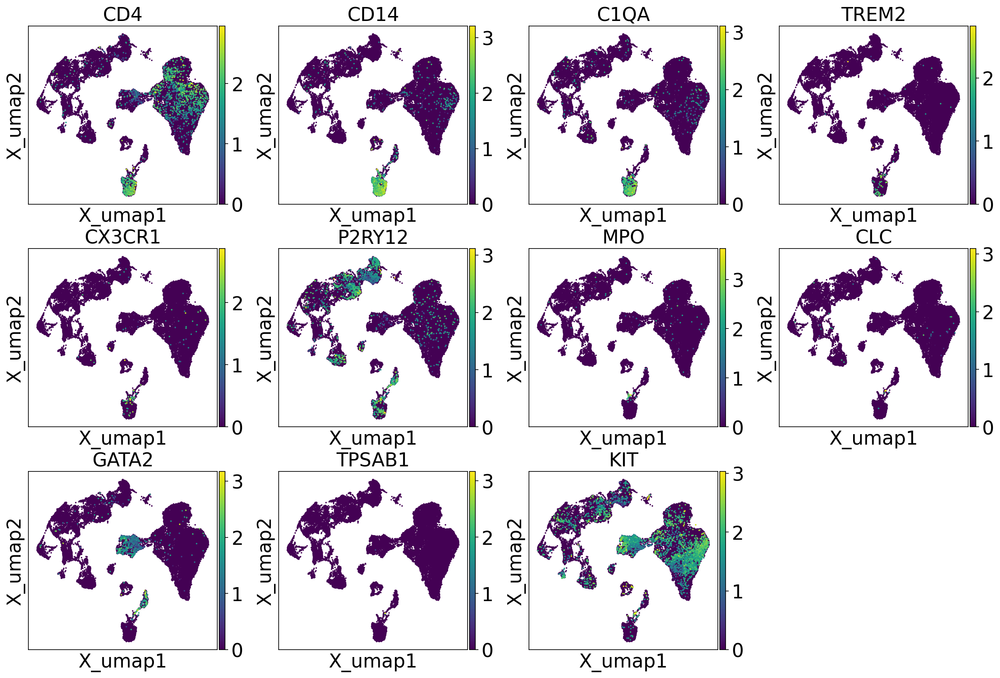

In [124]:
sc.pl.embedding(full_adata, 'X_umap', color=[  "CD4", "CD14","C1QA","TREM2","CX3CR1","P2RY12", "MPO", "CLC", "GATA2","TPSAB1","KIT"],  size= 12,  legend_loc="on data")

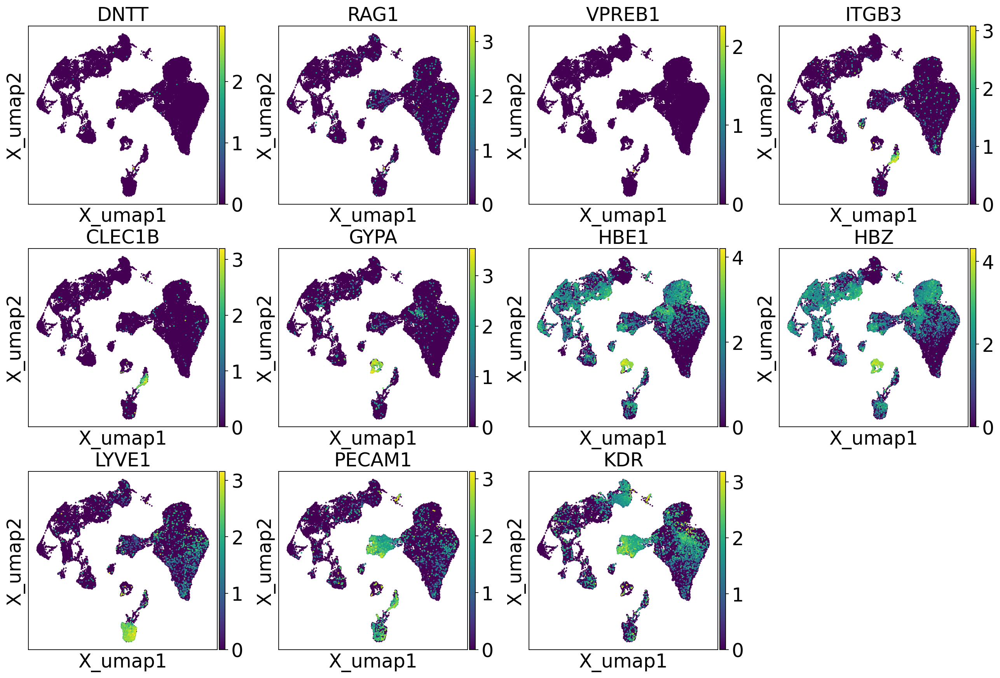

In [129]:
sc.pl.embedding(full_adata, 'X_umap', color=[ "DNTT","RAG1","VPREB1","ITGB3", "CLEC1B","GYPA","HBE1","HBZ","LYVE1","PECAM1","KDR"],  size= 12,  legend_loc="on data")

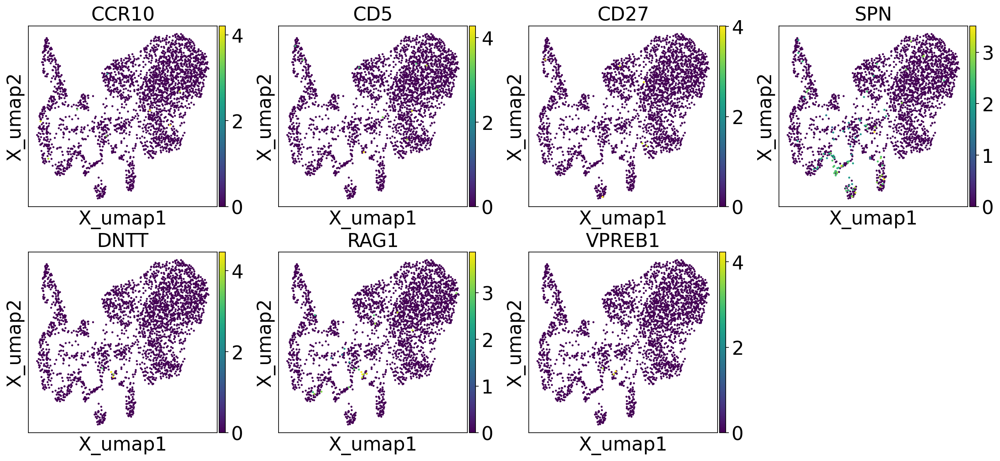

In [136]:
sc.pl.embedding(Immune_Subset, 'X_umap', color=["CCR10","CD5", "CD27",  "SPN", "DNTT","RAG1","VPREB1"],  size= 22,  legend_loc="on data")